<a href="https://colab.research.google.com/github/miguelcimat/MagicalTown/blob/main/PueblosMagicos.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Analysis of magical towns

In [ ]:
#!/usr/bin/env python
# -*- coding: utf-8 -*-
"""
Created on Fri Feb 19 00:08:42 2021

@author: miguel
"""

import csv
import os
import time
import re
import sys
import math
import shutil
import io
import collections
import pandas as pd


import numpy as np
import pandas as pd
import re
import nltk
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer
from nltk import wordpunct_tokenize, WordNetLemmatizer, sent_tokenize, pos_tag
from nltk.corpus import stopwords as sw, wordnet as wn
from keras.preprocessing.text import Tokenizer
from nltk import word_tokenize
from nltk.tokenize.toktok import ToktokTokenizer
toktok = ToktokTokenizer()
import nltk
nltk.download('stopwords')
from nltk.corpus import stopwords
import string
from nltk.stem import SnowballStemmer
stemmer = SnowballStemmer('spanish')


from gensim import corpora
from gensim.models import LsiModel

from gensim.models.coherencemodel import CoherenceModel

import matplotlib.pyplot as plt

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
def extraeDocumentos(carpeta):

  files = os.listdir(carpeta);
  files_res = [];
  for file in files:
    #if '_reviews.csv' in city:
    files_res.append(file);

  return files_res;

## Load Data

In [ ]:
print(str(len(extraeDocumentos("drive/MyDrive/PueblosMagicos"))))
pueblos = extraeDocumentos("drive/MyDrive/PueblosMagicos");



1560


In [ ]:
def juntarOpiniones(pueblos, dir, lim = 1000000):

  datosFinales = pd.DataFrame({"Author": [],
                    "Titulo": [],
                    "Review": [],
                    "Calificacion": [],
                    "OrigenAutor": [],
                    "FechaOpinion": [],
                    "FechaEstadia": [],
                    "Pueblo": [],
                    "Estado": [],
                    "Pais": [],
                    "Tipo": [],
                    "Lugar": []});
  lugar = [];
  for i in range(len(pueblos)):
      ini  = len(datosFinales.columns)
      dirFile = dir + "/" + pueblos[i];
      #print(dirFile)
      datos = pd.read_csv(dirFile, encoding='latin-1');
      if len(datos.columns) != 11:
        print(pueblos[i])
      #print(len(datos.columns))
      datosFinales = pd.concat([datosFinales, datos], axis=0)
      fin  = len(datosFinales.columns)
      if not ini == fin:
        print(pueblos[i])
      #print(f"{i+1}/{len(pueblos)}");
      lugar = lugar + ([pueblos[i].split(".")[0]])*len(datos);
      if i == lim-1:
        break;

  datosFinales['Lugar'] = np.array(lugar)
  return datosFinales;





In [ ]:
datosPueblosMagicos = juntarOpiniones(pueblos, "drive/MyDrive/PueblosMagicos")

In [ ]:
len(datosPueblosMagicos)

314024

In [ ]:
datosPueblosMagicos = datosPueblosMagicos.drop(['OrigenAutor','FechaOpinion' ], axis=1)

In [ ]:
datosPueblosMagicos.columns

Index(['Author', 'Titulo', 'Review', 'Calificacion', 'OrigenAutor',
       'FechaOpinion', 'FechaEstadia', 'Pueblo', 'Estado', 'Pais', 'Tipo',
       'Lugar'],
      dtype='object')

In [ ]:
datosPueblosMagicos.to_csv('drive/MyDrive/PueblosMagicosCompleto.csv');

## Some statistics

In [ ]:

b = []
porcentaje_positivo = 0;
porcentaje_negativo = 0;
for i in range(1, 6):
  clase = len(datosPueblosMagicos[datosPueblosMagicos['Calificacion'] == 1.0*i]);
  todo = len(datosPueblosMagicos)
  porcentaje = (100 * clase) / todo
  print(f"{i}: {porcentaje} %")
  if i <= 3:
    porcentaje_negativo += porcentaje;
  else:
    porcentaje_positivo += porcentaje;

print(f"Porcentaje positivo: {porcentaje_positivo}");
print(f"Porcentaje negativo: {porcentaje_negativo}");





1: 2.6249586018903015 %
2: 2.621137237918121 %
3: 7.558976383970652 %
4: 21.804702825261764 %
5: 65.39022495095917 %
Porcentaje positivo: 87.19492777622094
Porcentaje negativo: 12.805072223779074


In [ ]:
a = [];
b = []
for i in range(1, 6):
  print(f"{i}: {len(datosPueblosMagicos[datosPueblosMagicos['Calificacion'] == 1.0*i])}")
  a.append(math.log2(len(datosPueblosMagicos[datosPueblosMagicos['Calificacion'] == 1.0*i])))
  b.append(len(datosPueblosMagicos[datosPueblosMagicos['Calificacion'] == 1.0*i]))
print(f"Total: {len(datosPueblosMagicos)}");

1: 8243
2: 8231
3: 23737
4: 68472
5: 205341
Total: 314024


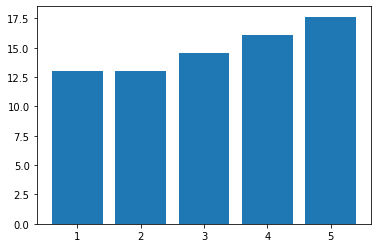

In [ ]:
x = [1,2,3,4,5];
plt.bar(x, a)
plt.show()

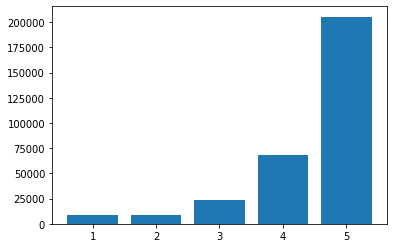

In [ ]:
x = [1,2,3,4,5];
plt.bar(x, b)
plt.show()

In [ ]:
datosPueblosMagicos[datosPueblosMagicos['Calificacion'] == 1.0].head()

,Author,Titulo,Review,Calificacion,OrigenAutor,FechaOpinion,FechaEstadia,Pueblo,Estado,Pais,Tipo,Lugar
2,475jos_j,No me agrado el sabor de sus alimentos,Espero que su fuerte sean los cortes por que y...,1.0,NaN,30 de septiembre de 2019,septiembre de 2019,Metepec,Estado_de_Mexico,Mexico,Restaurant,Restaurante_Casa_Avila_Satelite-Metepec
4,mauriciocR3602UA,Pésimo servicio,"Tardan muchísimo en servir los platillos, me p...",1.0,NaN,1 de marzo de 2019,marzo de 2019,Metepec,Estado_de_Mexico,Mexico,Restaurant,Mi_Gusto_Es-Metepec
6,laloheredia,Ahórrense la visita.,"A menos que tengan un vale promocional, una ap...",1.0,NaN,12 de diciembre de 2018,diciembre de 2018,Metepec,Estado_de_Mexico,Mexico,Restaurant,Mi_Gusto_Es-Metepec
21,29gildab,Comida,Lo peor de ese lugar es ir y no poder platicar...,1.0,NaN,9 de septiembre de 2017,septiembre de 2017,Metepec,Estado_de_Mexico,Mexico,Restaurant,Mi_Gusto_Es-Metepec
28,mayteg475,Mala experiencia,El lugar está bien pero la comida es grasosa y...,1.0,NaN,11 de abril de 2017,abril de 2017,Metepec,Estado_de_Mexico,Mexico,Restaurant,Mi_Gusto_Es-Metepec


In [ ]:
def cuantosHay(etiqueta = 'Estado'):

  return len(set(datosPueblosMagicos[etiqueta]))



In [ ]:
cuantosHay('Estado')

29

In [ ]:
cuantosHay('Pueblo')

95

In [ ]:
cuantosHay('Lugar')

1560

In [ ]:
datosPueblosMagicos.columns

Index(['Author', 'Titulo', 'Review', 'Calificacion', 'OrigenAutor',
       'FechaOpinion', 'FechaEstadia', 'Pueblo', 'Estado', 'Pais', 'Tipo',
       'Lugar'],
      dtype='object')

In [ ]:
datosPueblosMagicos['Calificacion'].mean()

4.447140982854814

In [ ]:
datosPueblosMagicos['Calificacion'].std()

0.9330870758141036

In [ ]:
def obtenPromedios(datosPueblosMagicos, etiqueta = 'Estado', index = 1):

  estados = list(set(datosPueblosMagicos[etiqueta]));
  #estados.sort();

  promedios = [];
  for estado in estados:

    promedio = datosPueblosMagicos[datosPueblosMagicos[etiqueta] == estado]['Calificacion'].mean();
    #print(f"{estado}: {promedio}");
    promedios.append([estado, promedio, len(datosPueblosMagicos[datosPueblosMagicos[etiqueta] == estado])]);


  promedios  = sorted(promedios, key=lambda x: -x[index])
  return promedios

In [ ]:
def obtenPromediosPonderado(datosPueblosMagicos, etiqueta = 'Estado', index = 2):

  estados = list(set(datosPueblosMagicos[etiqueta]));
  #estados.sort();

  promedios = [];
  for estado in estados:

    promedio = datosPueblosMagicos[datosPueblosMagicos[etiqueta] == estado]['Calificacion'].mean();
    califiacion = promedio * (len(datosPueblosMagicos[datosPueblosMagicos[etiqueta] == estado]) /len(datosPueblosMagicos[etiqueta]));
    #print(f"{estado}: {promedio}");
    promedios.append([estado, promedio, len(datosPueblosMagicos[datosPueblosMagicos[etiqueta] == estado]), califiacion]);


  promedios  = sorted(promedios, key=lambda x: -x[index])
  return promedios

In [ ]:
obtenPromedios(datosPueblosMagicos, etiqueta = 'Estado', index = 1)

[['Zacatecas', 4.62890625, 256],
 ['Aguascalientes', 4.613365155131265, 838],
 ['Sonora', 4.5477031802120145, 283],
 ['Tabasco', 4.533333333333333, 15],
 ['QuintanaRoo', 4.530346444386559, 122848],
 ['San_Luis_Potosi', 4.526482213438735, 3795],
 ['Baja_CaliforniaSur', 4.526374006221915, 14465],
 ['Colima', 4.501082251082251, 924],
 ['Oaxaca', 4.468541820873427, 2702],
 ['Yucatan', 4.46130046662609, 19716],
 ['Chiapas', 4.444208813874444, 34423],
 ['Estado_de_Mexico', 4.438717432035918, 28287],
 ['Michoacan', 4.431332357247438, 6830],
 ['Nayarit', 4.416141957641671, 10482],
 ['Veracruz', 4.392012529365701, 6385],
 ['Puebla', 4.364489561386708, 10442],
 ['Baja_California', 4.353316326530612, 784],
 ['Guanajuato', 4.35038240917782, 2092],
 ['Tlaxcala', 4.34180790960452, 354],
 ['Jalisco', 4.29248112524563, 19338],
 ['Chihuahua', 4.254924242424242, 2640],
 ['Morelos', 4.243850058570871, 5122],
 ['Queretaro', 4.236566982737661, 8226],
 ['Campeche', 4.205128205128205, 39],
 ['Coahuila', 4.18

In [ ]:
obtenPromediosPonderado(datosPueblosMagicos, etiqueta = 'Estado', index = 2)

[['QuintanaRoo', 4.530346444386559, 122848, 1.7722976587776733],
 ['Chiapas', 4.444208813874444, 34423, 0.48716977046340404],
 ['Estado_de_Mexico', 4.438717432035918, 28287, 0.3998356813491962],
 ['Yucatan', 4.46130046662609, 19716, 0.28010279469085164],
 ['Jalisco', 4.29248112524563, 19338, 0.2643364838356304],
 ['Baja_CaliforniaSur', 4.526374006221915, 14465, 0.2084999872621201],
 ['Nayarit', 4.416141957641671, 10482, 0.14740911522686165],
 ['Puebla', 4.364489561386708, 10442, 0.14512903472346064],
 ['Queretaro', 4.236566982737661, 8226, 0.11097877869207448],
 ['Michoacan', 4.431332357247438, 6830, 0.0963811683183451],
 ['Veracruz', 4.392012529365701, 6385, 0.08930209155988078],
 ['Guerrero', 4.167944018660447, 6002, 0.07966270094005554],
 ['Morelos', 4.243850058570871, 5122, 0.06922082388607241],
 ['San_Luis_Potosi', 4.526482213438735, 3795, 0.05470282526176343],
 ['Oaxaca', 4.468541820873427, 2702, 0.03844929050008917],
 ['Chihuahua', 4.254924242424242, 2640, 0.03577115124958602],


In [ ]:
obtenPromedios(datosPueblosMagicos, etiqueta = 'Pueblo', index = 1)

[['Linares', 4.928571428571429, 14],
 ['Teposcolula', 4.894736842105263, 19],
 ['Capulalpam', 4.875, 32],
 ['Zempoala', 4.823529411764706, 17],
 ['Casas_Grandes', 4.7894736842105265, 19],
 ['Aquismon', 4.717703349282297, 627],
 ['Calvillo', 4.700949367088608, 632],
 ['Xico', 4.6801872074882995, 641],
 ['Salvatierra', 4.670520231213873, 173],
 ['Yuriria', 4.647058823529412, 17],
 ['Guadalupe', 4.646341463414634, 164],
 ['San_Sebastian_del_Oeste', 4.6395939086294415, 788],
 ['Mani', 4.619318181818182, 176],
 ['Jerez', 4.5978260869565215, 92],
 ['Teotihuacan', 4.591084337349398, 8300],
 ['Batopilas', 4.585714285714285, 70],
 ['Metepec', 4.5709472849782005, 5046],
 ['Loreto', 4.554541999239833, 7893],
 ['Santa_Clara_del_Cobre', 4.55, 40],
 ['Alamos', 4.5477031802120145, 283],
 ['Bacalar', 4.541332470892626, 15460],
 ['Tlalpujahua', 4.540816326530612, 196],
 ['Tulum', 4.537334630049862, 64779],
 ['Tapijulapa', 4.533333333333333, 15],
 ['Xilitla', 4.516082573211714, 2083],
 ['Isla_Mujeres', 

In [ ]:
obtenPromediosPonderado(datosPueblosMagicos, etiqueta = 'Pueblo', index = 2)

[['Tulum', 4.537334630049862, 64779, 0.9359921534659771],
 ['Isla_Mujeres', 4.515736112088995, 42609, 0.6127270527093471],
 ['San_Cristobal_de_las_Casas', 4.461381786996838, 18657, 0.2650625429903447],
 ['Valladolid', 4.465892685274302, 16624, 0.23641823554887526],
 ['Bacalar', 4.541332470892626, 15460, 0.22357845260234885],
 ['Palenque', 4.437706968871882, 13589, 0.1920362774819759],
 ['Sayulita', 4.416141957641671, 10482, 0.14740911522686165],
 ['Valle_de_Bravo', 4.358393045929755, 8513, 0.11815338954984334],
 ['Teotihuacan', 4.591084337349398, 8300, 0.12134741293659085],
 ['Loreto', 4.554541999239833, 7893, 0.11447851119659642],
 ['TodosSantos', 4.4925441265976875, 6572, 0.09402147606552366],
 ['Patzcuaro', 4.428571428571429, 6363, 0.0897351794767279],
 ['Taxco', 4.167944018660447, 6002, 0.07966270094005554],
 ['Tlaquepaque', 4.098908712974191, 5773, 0.07535411306142206],
 ['Ajiji', 4.383955223880597, 5360, 0.07482867551524724],
 ['Tequisquiapan', 4.261146496815287, 5181, 0.07030354

In [ ]:
promedios = obtenPromedios(datosPueblosMagicos, etiqueta = 'Lugar', index = 1)
promedios[:100]

[['Taller_17-Todos_Santos_Baja', 5.0, 22],
 ['El_Ciclo_Restaurante-Tecate', 5.0, 13],
 ['Las_3_Tzimoleras-Comitan', 5.0, 37],
 ['Paseos_A_Caballo_Vaquero-Creel', 5.0, 52],
 ['Mulik_Spa-Valladolid', 5.0, 27],
 ['Mahache-Isla_Mujeres', 5.0, 23],
 ['Taol-Cuetzalan', 5.0, 12],
 ['Spa_El_Santuario-Valle_de_Bravo', 5.0, 22],
 ['Ukai-Tulum_Yucatan', 5.0, 17],
 ['Barrica_Y_Artesa-Zacatlan', 5.0, 19],
 ['Cuari-Santiago', 5.0, 24],
 ['Ruta_del_Cafe_Aristoteles-Xicotepec', 5.0, 17],
 ['Casa_Makawe-Sayulita', 5.0, 33],
 ['D_Tapeo_Restaurante-Huamantla', 5.0, 18],
 ['Onyx_Tulum_Restaurant_Bar-Tulum', 5.0, 21],
 ['Aua_De_Mar-Tulum', 5.0, 25],
 ['Blue_Palm_Bacalar-Bacalar', 5.0, 27],
 ['Casa_Paraiso_Restaurante_Bar-Sayulita', 5.0, 36],
 ['Autor-Tulum_Yucatan', 5.0, 23],
 ['Asadero_Dona_Meche_Xico-Xico', 5.0, 18],
 ['Casa_Salles_Hotel_Boutique-Tequila', 5.0, 35],
 ['Al_Forno_Pizzeria_Ristorante_italiano-Patzcuaro', 5.0, 32],
 ['TPC_Danzante_Bay-Loreto', 5.0, 24],
 ['Blue_Nation-Loreto', 4.993589743589

In [ ]:
promedios[-100:]

[['El_Aguaje_Del_Moro-Jalpan_de_Serra', 3.642857142857143, 28],
 ['El_Abajeno-Tlaquepaque_Guadalajara', 3.6416040100250626, 399],
 ['Hotel_Feregrino-Bernal', 3.63768115942029, 69],
 ['Plaza_Magnolias_Hotel-San_Cristobal_de_las_Casas', 3.636986301369863, 146],
 ['El_Campanario-Chiapa_de_Corzo', 3.634920634920635, 63],
 ['Presa_La_Boca-Santiago', 3.632911392405063, 79],
 ['El_Farol-Restaurante-Parras', 3.632183908045977, 87],
 ['Mi_Gusto_Es-Metepec', 3.6310679611650487, 103],
 ['Estancia_Inn_Hotel-Tecate', 3.627450980392157, 51],
 ['Hotel_Rio_Tequisquiapan-Tequisquiapan', 3.625730994152047, 171],
 ['Los_Cafetales-Cuetzalan', 3.625, 24],
 ['Hotel_Posada_La_Escondida-Zacatlan', 3.625, 40],
 ['Capricho_s_Restaurante_Bar-Tequisquiapan', 3.622950819672131, 61],
 ['Restaurante_La_Tradicion-Huasca_de_Ocampo', 3.6226415094339623, 53],
 ['Unico_Avandaro_Hotel_Boutique-Valle_de_Bravo', 3.6216216216216215, 37],
 ['Restaurante_Ppp-Zacatlan', 3.6206896551724137, 58],
 ['El_Carruaje-Dolores_Hidalgo', 

In [ ]:
promedios = obtenPromediosPonderado(datosPueblosMagicos, etiqueta = 'Lugar', index = 2)
promedios[:100]

[['Tulum_Archaeological_Site-Tulum',
  4.502432958477509,
  18496,
  0.2651931062593942],
 ['Zona_Arqueologica_Teotihuacan-San_Juan_Teotihuacan',
  4.7985088197854155,
  5499,
  0.08402860927827173],
 ['Playa_Norte-Isla_Mujeres', 4.6939522342064715, 5192, 0.07760871780500854],
 ['Dreams_Tulum_Resort_Spa-Tulum',
  4.316490583371612,
  4354,
  0.059848928744299805],
 ['Cenotes_Dos_Ojos-Tulum', 4.607452112306481, 3811, 0.05591610832293073],
 ['Mango_Cafe_Isla-Isla_Mujeres',
  4.765443712762622,
  3189,
  0.04839439023768884],
 ['Playa_Paraiso-Tulu', 4.484608060933037, 3151, 0.04499974524240185],
 ['Mia_Reef_Isla_Mujeres-Isla_Mujeres',
  4.260159893404397,
  3002,
  0.04072618653351337],
 ['Punta_Sur-Isla_Mujeres', 4.582431307243963, 2402, 0.035051461034825364],
 ['Zona_Arqueologica_de_Palenque-Palenque',
  4.841179058512979,
  2273,
  0.03504190762489492],
 ['Privilege_Aluxes-Isla_Mujeres',
  4.481398476019722,
  2231,
  0.03183833082821695],
 ['Gran_Cenote-Tulum', 4.286582515194016, 2139

In [ ]:
obtenPromedios(datosPueblosMagicos, etiqueta = 'Tipo', index = 1)

[['Attractive', 4.519760524065076, 106399],
 ['Restaurant', 4.4681263942792535, 130892],
 ['Hotel', 4.310648612722036, 76733]]

In [ ]:
obtenPromediosPonderado(datosPueblosMagicos, etiqueta = 'Tipo', index = 1)

[['Attractive', 4.519760524065076, 106399, 1.5314052429113696],
 ['Restaurant', 4.4681263942792535, 130892, 1.8624117901816422],
 ['Hotel', 4.310648612722036, 76733, 1.0533239497618017]]

## Pre processing

In [ ]:
def remove_stop_words(text, language= 'english'):
  stop = set(stopwords.words(language)) | set(['vale', 'pena', 'lugar', 'si']);
  return  " ".join([i for i in text.split(" ") if not i in stop])

def remove_not_important_words(text, importantWords):
  return  " ".join([i for i in text.split(" ") if i in importantWords]);

def remove_punctuation_mark(text, replace = " "):
  return re.sub('[%s]' % re.escape(string.punctuation +"¡¿"), replace, text);

def replace_digits(text, replace = "d"):
  return re.sub('[%s]' % re.escape("0123456789"), replace, text);

def tokens(text):
  return toktok.tokenize(text);

def remove_word_frec_lower(text, rep, minrep = 1):
  return  " ".join([i for i in text.split(" ") if rep[i] >= minrep])

def get_bigramas(text):

  palabras = text
  new_text = "";
  for i in range(len(palabras)-1):
    if i > 0:
     new_text += " ";
    new_text += palabras[i] + "_" + palabras[i+1];
  return new_text;

def preprocess(text, removeStopWords = False, stem = False):

  text = text.lower();

  if removeStopWords:
    text = remove_stop_words(text, language='spanish');

  text = remove_punctuation_mark(text);

  text = replace_digits(text);

  text = tokens(text);

  if stem:
    text = [stemmer.stem(t) for t in text];

  return text;


In [ ]:
voc = set()
longitud = [];
for texto in datosPueblosMagicos['Review']:
  t = preprocess(texto);
  voc = voc | set(t);
  #print(t)
  longitud.append(len(t))

longitud = np.array(longitud)
print(len(voc));
print(np.min(longitud));
print(np.max(longitud));
print(np.average(longitud));
print(np.std(longitud));




139134
2
1493
61.557708964919875
50.82151659405952


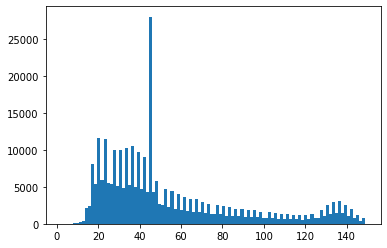

In [ ]:
plt.hist(longitud[longitud<150], 100)
plt.show()

In [ ]:
def porClase(datosPueblosMagicos, clase):
  voc = set()
  longitud = [];
  for texto in datosPueblosMagicos[datosPueblosMagicos['Calificacion']==clase]['Review']:
    t = preprocess(texto);
    voc = voc | set(t);
    #print(t)
    longitud.append(len(t))

  longitud = np.array(longitud)
  print(len(voc));
  print(np.min(longitud));
  print(np.max(longitud));
  print(np.average(longitud));
  print(np.std(longitud));
  plt.hist(longitud[longitud<150], 100)
  plt.show()

28086
9
1009
81.34878078369526
63.303608670502356


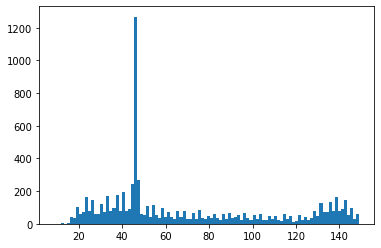

26781
11
762
81.0620823715223
59.216183134561255


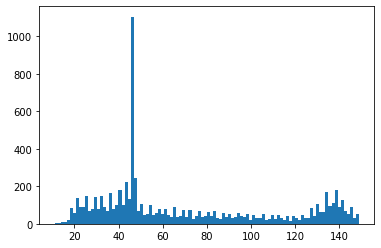

39826
7
877
70.82685259299828
52.220970077249206


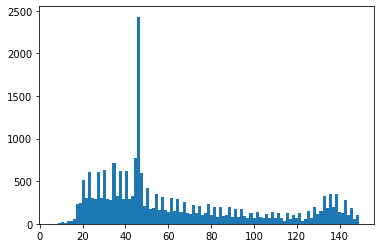

62151
2
1339
64.5617770767613
50.54949525391289


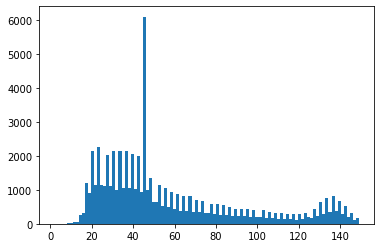

106718
3
1493
57.90819660954217
49.23319779581376


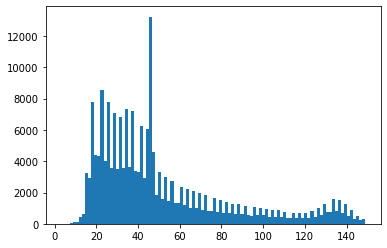

In [ ]:
for i in range(1,6):
  porClase(datosPueblosMagicos, 1.0*i)

In [ ]:
repeticiones = dict()
total = len(datosPueblosMagicos['Review'])
i= 1;
for texto in datosPueblosMagicos['Review']:
  t = preprocess(texto);
  for p in t:
    if not p in repeticiones:
      repeticiones[p] = 0;
    repeticiones[p]+=1;



  print(f"{i}/{total}");
  i += 1;


Se han truncado las últimas 5000 líneas del flujo de salida.
309025/314024
309026/314024
309027/314024
309028/314024
309029/314024
309030/314024
309031/314024
309032/314024
309033/314024
309034/314024
309035/314024
309036/314024
309037/314024
309038/314024
309039/314024
309040/314024
309041/314024
309042/314024
309043/314024
309044/314024
309045/314024
309046/314024
309047/314024
309048/314024
309049/314024
309050/314024
309051/314024
309052/314024
309053/314024
309054/314024
309055/314024
309056/314024
309057/314024
309058/314024
309059/314024
309060/314024
309061/314024
309062/314024
309063/314024
309064/314024
309065/314024
309066/314024
309067/314024
309068/314024
309069/314024
309070/314024
309071/314024
309072/314024
309073/314024
309074/314024
309075/314024
309076/314024
309077/314024
309078/314024
309079/314024
309080/314024
309081/314024
309082/314024
309083/314024
309084/314024
309085/314024
309086/314024
309087/314024
309088/314024
309089/314024
309090/314024
309091/314024
3

In [ ]:
repeticiones['violencia']

20

In [ ]:
conteo = [];
r = [];
for palabra in repeticiones:
  conteo.append([palabra, repeticiones[palabra]]);
  r.append(repeticiones[palabra]);

conteo  = sorted(conteo, key=lambda x: -x[1]);

[271077, 35536, 75245, 2891, 62925, 11386, 864893, 70752, 956, 13606]


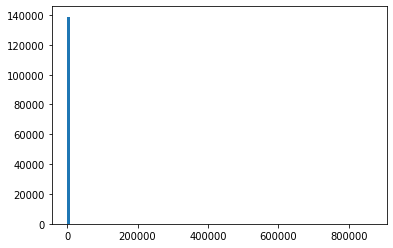

In [ ]:
print(r[:10])


plt.hist(r, 100)
plt.show()

In [ ]:
conteo[:200]

[['de', 864893],
 ['y', 761522],
 ['la', 693289],
 ['el', 566705],
 ['que', 473425],
 ['en', 459095],
 ['es', 349378],
 ['un', 323023],
 ['a', 291211],
 ['muy', 271077],
 ['una', 233999],
 ['para', 224296],
 ['no', 212237],
 ['con', 207444],
 ['los', 198116],
 ['las', 195697],
 ['por', 147455],
 ['lugar', 141266],
 ['lo', 125974],
 ['del', 122152],
 ['más', 117966],
 ['pero', 116863],
 ['nos', 115809],
 ['comida', 109057],
 ['se', 108995],
 ['era', 90692],
 ['al', 87628],
 ['me', 77073],
 ['todo', 77024],
 ['este', 76514],
 ['servicio', 75245],
 ['hotel', 73514],
 ['son', 71394],
 ['d', 70752],
 ['si', 70722],
 ['fue', 66799],
 ['excelente', 64938],
 ['como', 64348],
 ['hay', 63567],
 ['su', 62925],
 ['playa', 61092],
 ['dd', 58922],
 ['mi', 56666],
 ['te', 55691],
 ['bien', 55448],
 ['buena', 53429],
 ['sin', 50525],
 ['personal', 47710],
 ['mejor', 47374],
 ['o', 46870],
 ['restaurante', 45955],
 ['está', 45639],
 ['esta', 43321],
 ['tiene', 37241],
 ['ya', 35785],
 ['mucho', 35710],

In [ ]:
conteo[-70450:-70390]

[['izcoatl', 2],
 ['bolillitos', 2],
 ['finesa', 2],
 ['metepequense', 2],
 ['aereopuerto', 2],
 ['firm', 2],
 ['acuitlapa', 2],
 ['atiendas', 2],
 ['kompras', 2],
 ['kn', 2],
 ['hayer', 2],
 ['delmonico', 2],
 ['sonotex', 2],
 ['himalaya', 2],
 ['pollon', 2],
 ['mezcalinis', 2],
 ['krispy', 2],
 ['carpio', 2],
 ['unicornios', 2],
 ['bicentenaria', 2],
 ['cioccolato', 2],
 ['aurugula', 2],
 ['calzonne', 2],
 ['romas', 2],
 ['tilicos', 2],
 ['fodongas', 2],
 ['revoloteado', 2],
 ['cornudos', 2],
 ['mufins', 2],
 ['xicoy', 2],
 ['restaurantesmás', 1],
 ['jubilé', 1],
 ['sucuios', 1],
 ['silenció', 1],
 ['perecía', 1],
 ['lentejitas', 1],
 ['mmmhh', 1],
 ['derritiéndose', 1],
 ['pecesmás', 1],
 ['comprencible', 1],
 ['oráculo', 1],
 ['fisher´s', 1],
 ['infiero', 1],
 ['irracionalmente', 1],
 ['pansona', 1],
 ['infeciente', 1],
 ['agregarán', 1],
 ['superenfermo', 1],
 ['enjabonadas', 1],
 ['entrsda', 1],
 ['engordare', 1],
 ['scustomer', 1],
 ['kitcen', 1],
 ['onkempt', 1],
 ['headquarter

In [ ]:
def porClasePreProcessed(datosPueblosMagicos, clase):
  voc = set()
  longitud = [];
  for texto in datosPueblosMagicos[datosPueblosMagicos['Calificacion']==clase]['Review']:
    t = preprocess(texto, removeStopWords=True, stem=True);
    voc = voc | set(t);
    #print(t)
    longitud.append(len(t))

  longitud = np.array(longitud)
  print(len(voc));
  print(np.min(longitud));
  print(np.max(longitud));
  print(np.average(longitud));
  print(np.std(longitud));
  plt.hist(longitud[longitud<150], 100)
  plt.show()

In [ ]:
voc = set()
longitud = [];
for texto in datosPueblosMagicos['Review']:
  t = preprocess(texto, removeStopWords=True, stem=True);
  voc = voc | set(t);
  #print(t)
  longitud.append(len(t))

longitud = np.array(longitud)
print(len(voc));
print(np.min(longitud));
print(np.max(longitud));
print(np.average(longitud));
print(np.std(longitud));
plt.hist(longitud[longitud<150], 100)
plt.show()

13699
3
512
41.82045371830644
32.263981273646934


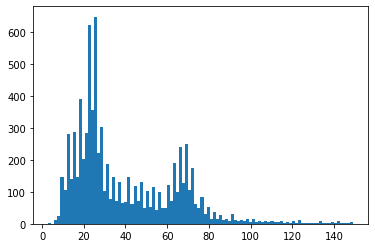

13401
5
407
41.44150164014093
30.571043475662236


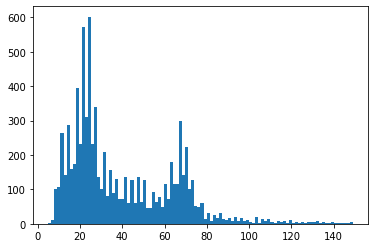

19922
3
467
36.1129460336184
26.79702673218236


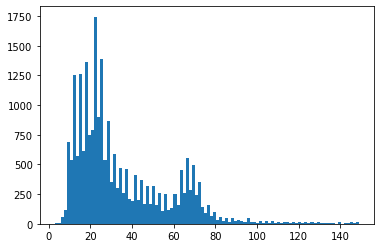

32478
2
1289
33.62919149433345
26.409840734834873


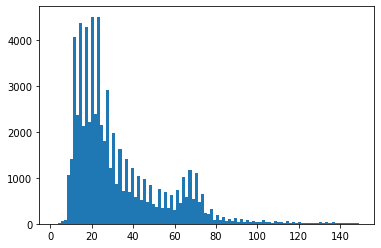

60152
1
741
30.890966733384953
26.09282500602339


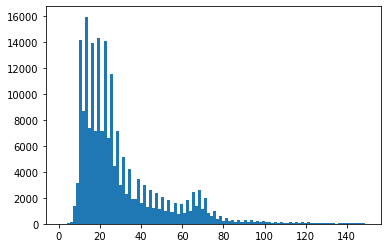

In [ ]:
for i in range(1, 6):
  porClasePreProcessed(datosPueblosMagicos, 1.0*i)

In [ ]:
def clasesEspecificadas(datosPueblosMagicos, polaridad, tipo):

  for clasePolaridad in polaridad:
    for claseType in tipo:
      nuevoframe = datosPueblosMagicos[datosPueblosMagicos['Calificacion']==clasePolaridad];
      nuevoframe = nuevoframe[nuevoframe['Tipo']==claseType];
      print(f"{clasePolaridad}-{claseType}: {len(nuevoframe)} ({100*len(nuevoframe)/len(datosPueblosMagicos)} %)")

def clasesEspecificadasConEstado(datosPueblosMagicos, polaridad, tipo, estados):

  for claseEstado in estados:
    for clasePolaridad in polaridad:
      for claseType in tipo:
        nuevoframe = datosPueblosMagicos[datosPueblosMagicos['Calificacion']==clasePolaridad];
        nuevoframe = nuevoframe[nuevoframe['Tipo']==claseType];
        nuevoframe = nuevoframe[nuevoframe['Estado']==claseEstado]

        print(f"{claseEstado}-{clasePolaridad}-{claseType}: {len(nuevoframe)} ({100*len(nuevoframe)/len(datosPueblosMagicos)} %)")

def promedioEstadoTipo(datosPueblosMagicos, tipo, estados):

  estados = sorted(estados);

  for claseEstado in estados:

    for claseType in tipo:
      nuevoframe = datosPueblosMagicos[datosPueblosMagicos['Estado']==claseEstado];
      nuevoframe = nuevoframe[nuevoframe['Tipo']==claseType];

      print(f"{claseEstado}-{claseType}: {len(nuevoframe)} ({100*len(nuevoframe)/len(datosPueblosMagicos)} %): Promedio: {nuevoframe['Calificacion'].mean()}")


In [ ]:
promedioEstadoTipo(datosPueblosMagicos, list(set(datosPueblosMagicos['Tipo'])), list(set(datosPueblosMagicos['Estado'])));


Aguascalientes-Hotel: 0 (0.0 %): Promedio: nan
Aguascalientes-Restaurant: 415 (0.13215550403790793 %): Promedio: 4.718072289156627
Aguascalientes-Attractive: 423 (0.13470308001936157 %): Promedio: 4.51063829787234
Baja_California-Hotel: 116 (0.03693985173107788 %): Promedio: 4.120689655172414
Baja_California-Restaurant: 570 (0.18151478867857235 %): Promedio: 4.421052631578948
Baja_California-Attractive: 98 (0.031207805772807174 %): Promedio: 4.23469387755102
Baja_CaliforniaSur-Hotel: 2393 (0.7620436654523222 %): Promedio: 4.547847889678228
Baja_CaliforniaSur-Restaurant: 8166 (2.60043818306881 %): Promedio: 4.455914768552535
Baja_CaliforniaSur-Attractive: 3906 (1.243853972944743 %): Promedio: 4.660522273425499
Campeche-Hotel: 39 (0.012419432909586529 %): Promedio: 4.205128205128205
Campeche-Restaurant: 0 (0.0 %): Promedio: nan
Campeche-Attractive: 0 (0.0 %): Promedio: nan
Chiapas-Hotel: 12131 (3.8630805288767736 %): Promedio: 4.299480669359492
Chiapas-Restaurant: 12002 (3.82200086617583

## Word clouds

In [ ]:
def plot_bar(data, top=5):
    fig = plt.figure()
    ax = fig.add_axes([0,0,2,1])
    ax.bar(x =data.iloc[:top,:].index, height = data.iloc[:top,0].values)
    plt.show()

In [ ]:
from wordcloud import WordCloud
def nubesdePalabrasTodos(textos):
  contador_palabras = dict();
  texto_limpio = ""
  for t in textos:
    t = preprocess(text=t, removeStopWords=True);
    texto_limpio += " ".join(t) + " ";
  #print(texto_limpio)


  word_cloud = WordCloud(height=1000, width=1000, background_color='white',max_words=150, min_font_size=5, collocation_threshold=10).generate(texto_limpio)

  #word_cloud.to_file("./img/ejemplo_sencillo.png") #Guardamos la imagen generada

  plt.figure(figsize=(10,8))
  plt.imshow(word_cloud)
  plt.axis('off')
  plt.tight_layout(pad=0)
  plt.show()

def nubesdePalabrasPorClase(datosPueblosMagicos, Etiqueta = 'Calificacion', clase = 1.0):

  textos = datosPueblosMagicos[datosPueblosMagicos[Etiqueta] == clase]['Review']
  nubesdePalabrasTodos(textos)

def nubesdePalabrasPorSubClase(datosPueblosMagicos, polaridad = [1.0, 2.0, 3.0, 4.0, 5.0], tipo = ['Attractive', 'Restaurant', 'Hotel']):

  for clasePolaridad in polaridad:
    for claseType in tipo:
      nuevoframe = datosPueblosMagicos[datosPueblosMagicos['Calificacion']==clasePolaridad];
      nuevoframe = nuevoframe[nuevoframe['Tipo']==claseType];
      textos = nuevoframe['Review']
      print(f"{clasePolaridad}-{claseType}")
      nubesdePalabrasTodos(textos)




IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



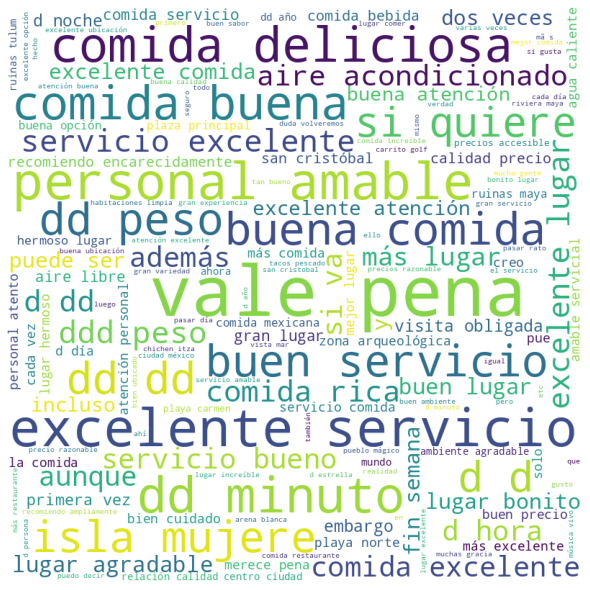

In [ ]:
nubesdePalabrasTodos(datosPueblosMagicos['Review']);

espero fuerte cortes pedí empanada gusto sabor agradable re frita pedí tallarines llevaron espagueti indique mesero espagueti dijo que tallarines bien así empecé comerlos pedi d quesos pareciera bañados aceite crema d quesos parte arriba seca nata recomiendo sin embargo área juegos niños padremás tardan muchísimo servir platillos paso recibir atención después hora pedí cuenta arte magia aparecieron platillos pedido obviamente rechazamos definitivamente volveremos menos vale promocional apuesta pagar hambre bestial alrededor cerrado entren restaurante espacialmente desastre carece vestíbulo servicios sanitarios sabrá oráculo si cuentan ventilación natural olor mesas cercanas infumable cambiar lado opuesto restaurante poder comer los platillos ganarían concurso cantidad grasa aceite sirven bendito carro cocteles cabe pasillos mesas constantemente chocan sillas y ocupantes mismas los postres dignos ser guardados cajón apetecen absoluto su terraza techada habilitada fumar solamente nocivo 

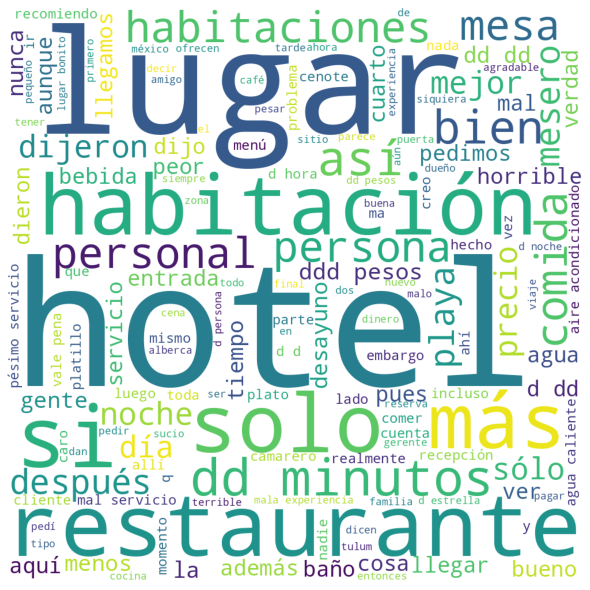

hice consumo sucursal toluca tollocan dejo mal sabor boca pedí ceviche pescado sirvieron ddd crudo cortaron pescado sirvieron verdura platillo siquiera tiempo más semana pasada mariscos súper congelados frescura luego simple añadimos tardanza solicitarla cuenta viajeros eviten lugar fiasco servicio regular comida realmente concepto texano pocas opciones realmente mejor texas ribs si costillas trata quedo grande concepto contry tasa sucia labial rosa café mal sabor servicio mesero olvida andar buscando recoja platos traiga segundo tiempo comida rica pizza bastante ordinaria ensaladas malas parece preparan mucha prisa mala presentación preparación tienen personal bastante desatento animo volver comer ahí ir tomarse fotos bien ido muchas ocasiones cada vez peor dejan subir pirámides si bien va puedes tomarte fotos poca gente comercio exterior interior ver zonas arqueológicas hecho descubrimiento cerrado público general bien si solo quieres conocer dar recorrido pirámide otra mal inah tene

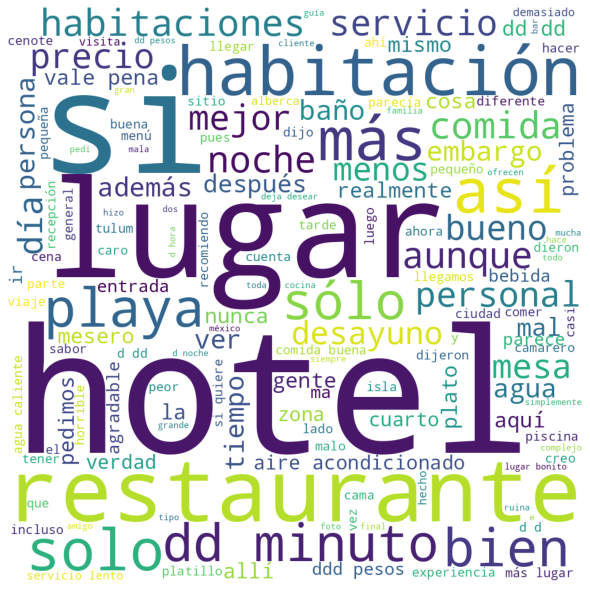

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



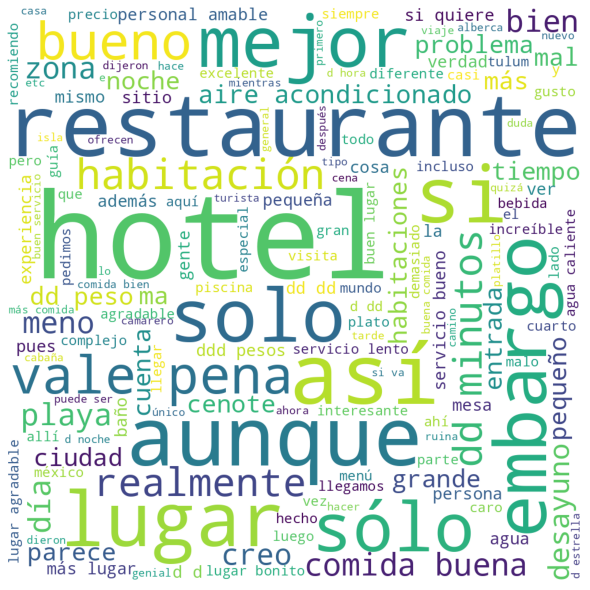

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



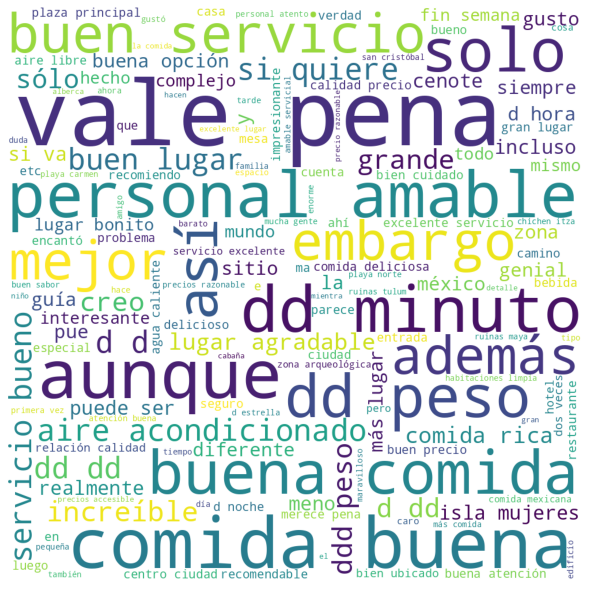

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



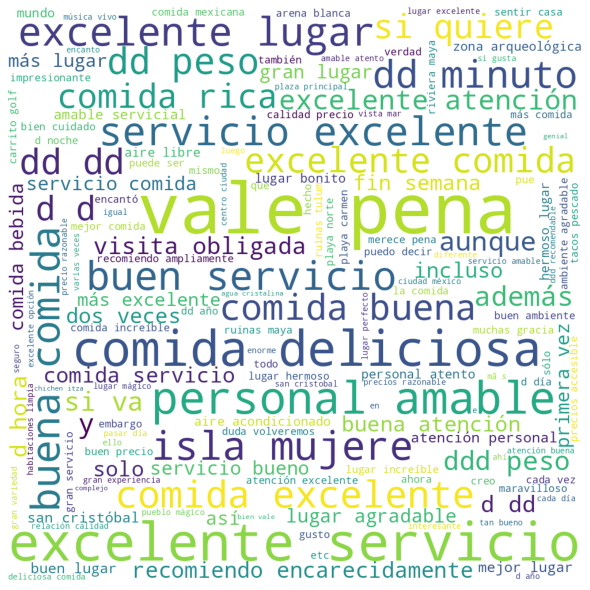

In [ ]:
for i in range(1, 6):
  nubesdePalabrasPorClase(datosPueblosMagicos, Etiqueta='Calificacion', clase=1.0*i);

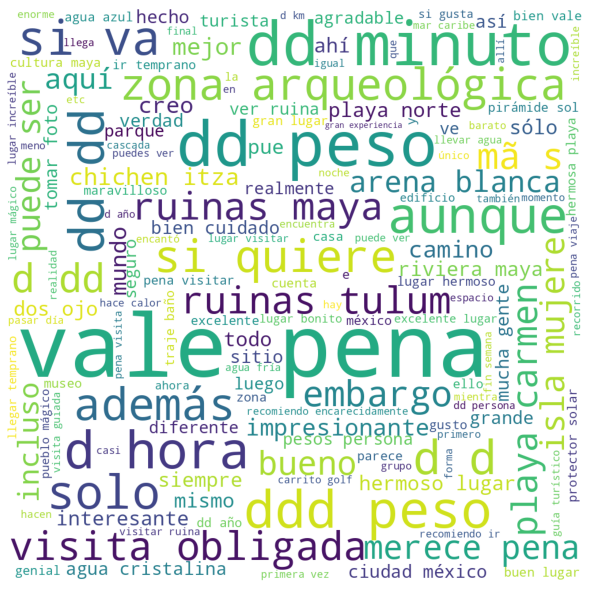

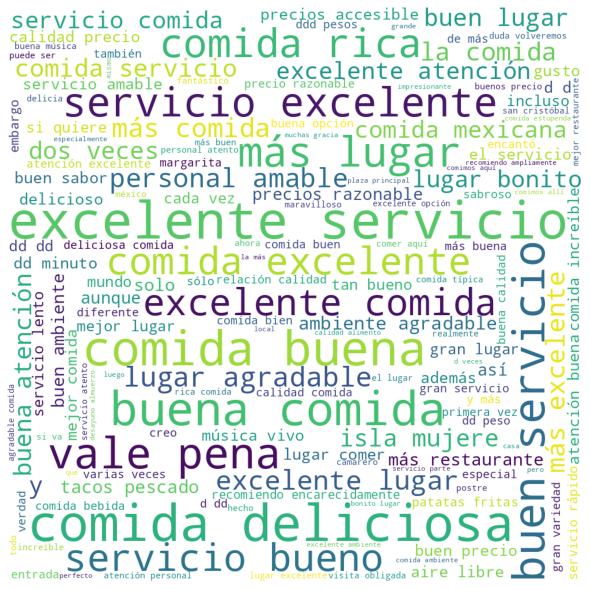

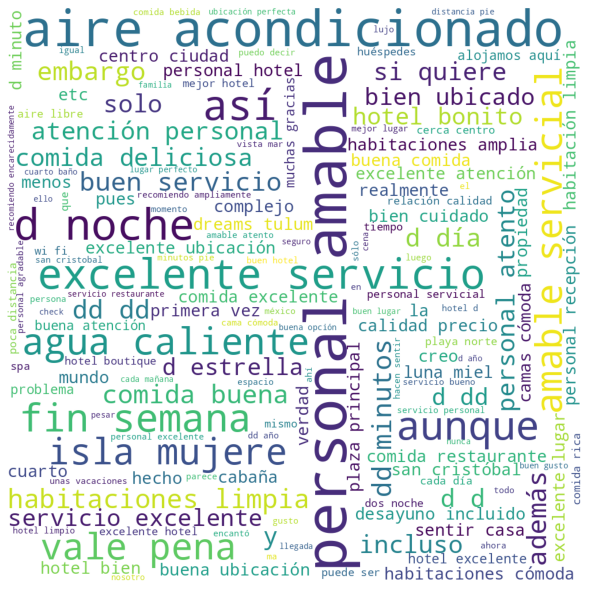

In [ ]:
nubesdePalabrasPorClase(datosPueblosMagicos, Etiqueta = 'Tipo', clase = 'Attractive')
nubesdePalabrasPorClase(datosPueblosMagicos, Etiqueta = 'Tipo', clase = 'Restaurant')
nubesdePalabrasPorClase(datosPueblosMagicos, Etiqueta = 'Tipo', clase = 'Hotel')


In [ ]:
polaridad = [1.0, 2.0, 3.0, 4.0, 5.0]
tipo = ['Attractive', 'Restaurant', 'Hotel']
estados = list(set(datosPueblosMagicos['Estado']));

clasesEspecificadas(datosPueblosMagicos, polaridad, tipo)

1.0-Attractive: 1386 (0.4413675387868443 %)
1.0-Restaurant: 3722 (1.1852597253713093 %)
1.0-Hotel: 3135 (0.9983313377321479 %)
2.0-Attractive: 1646 (0.5241637581840879 %)
2.0-Restaurant: 3546 (1.129213053779329 %)
2.0-Hotel: 3039 (0.9677604259547041 %)
3.0-Attractive: 7550 (2.404274832496879 %)
3.0-Restaurant: 9147 (2.9128346877945637 %)
3.0-Hotel: 7040 (2.2418668636792094 %)
4.0-Attractive: 25515 (8.125175145848726 %)
4.0-Restaurant: 25798 (8.215295646192647 %)
4.0-Hotel: 17159 (5.464232033220391 %)
5.0-Attractive: 70302 (22.387460831019286 %)
5.0-Restaurant: 88679 (28.239561307415993 %)
5.0-Hotel: 46360 (14.763202812523884 %)


In [ ]:
clasesEspecificadasConEstado(datosPueblosMagicos, polaridad, tipo, estados)

Chihuahua-1.0-Attractive: 3 (0.0009553409930451175 %)
Chihuahua-1.0-Restaurant: 45 (0.014330114895676763 %)
Chihuahua-1.0-Hotel: 38 (0.012100985911904822 %)
Chihuahua-2.0-Attractive: 10 (0.0031844699768170588 %)
Chihuahua-2.0-Restaurant: 42 (0.013374773902631646 %)
Chihuahua-2.0-Hotel: 51 (0.016240796881766998 %)
Chihuahua-3.0-Attractive: 83 (0.026431100807581587 %)
Chihuahua-3.0-Restaurant: 118 (0.03757674572644129 %)
Chihuahua-3.0-Hotel: 94 (0.029934017782080352 %)
Chihuahua-4.0-Attractive: 155 (0.04935928464066441 %)
Chihuahua-4.0-Restaurant: 277 (0.08820981835783252 %)
Chihuahua-4.0-Hotel: 292 (0.09298652332305811 %)
Chihuahua-5.0-Attractive: 360 (0.1146409191654141 %)
Chihuahua-5.0-Restaurant: 434 (0.13820599699386035 %)
Chihuahua-5.0-Hotel: 638 (0.20316918452092833 %)
Sinaloa-1.0-Attractive: 2 (0.0006368939953634117 %)
Sinaloa-1.0-Restaurant: 3 (0.0009553409930451175 %)
Sinaloa-1.0-Hotel: 25 (0.007961174942042647 %)
Sinaloa-2.0-Attractive: 10 (0.0031844699768170588 %)
Sinaloa-2.0

1.0-Attractive


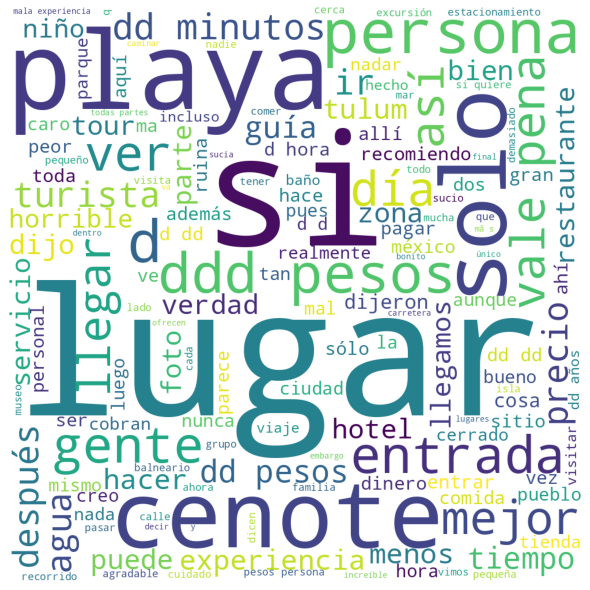

1.0-Restaurant


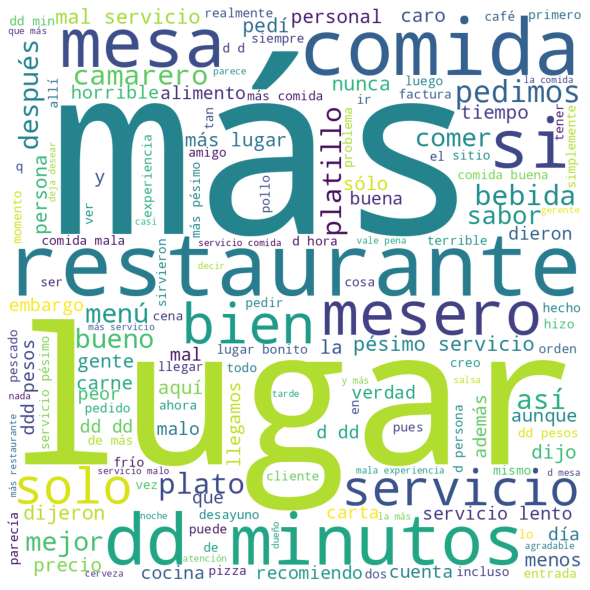

1.0-Hotel


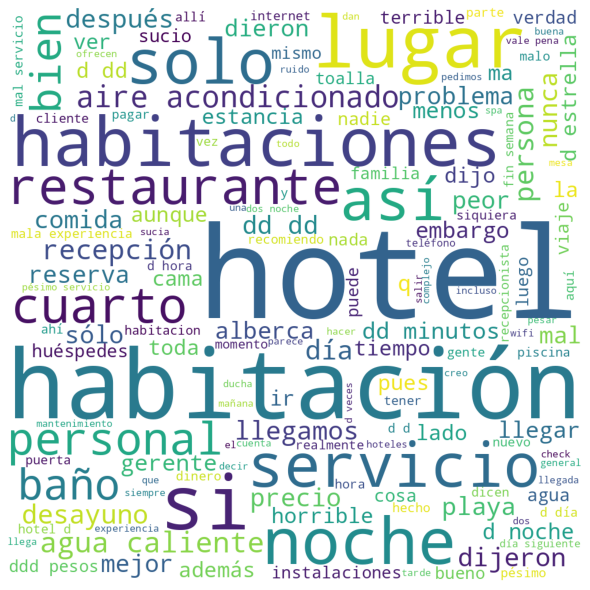

2.0-Attractive


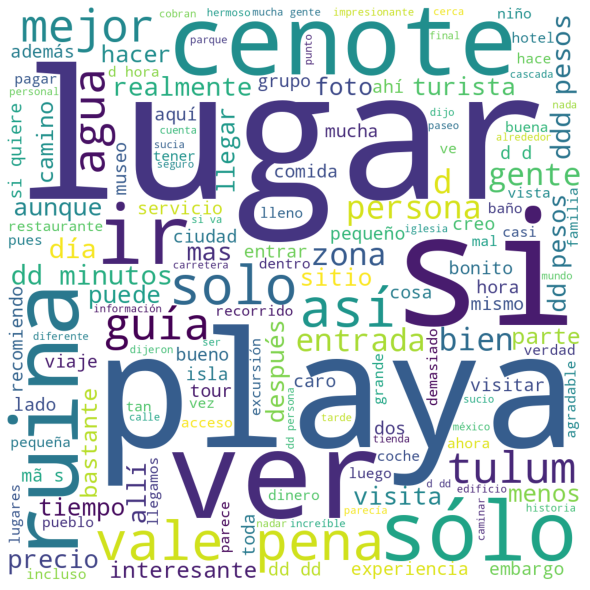

2.0-Restaurant


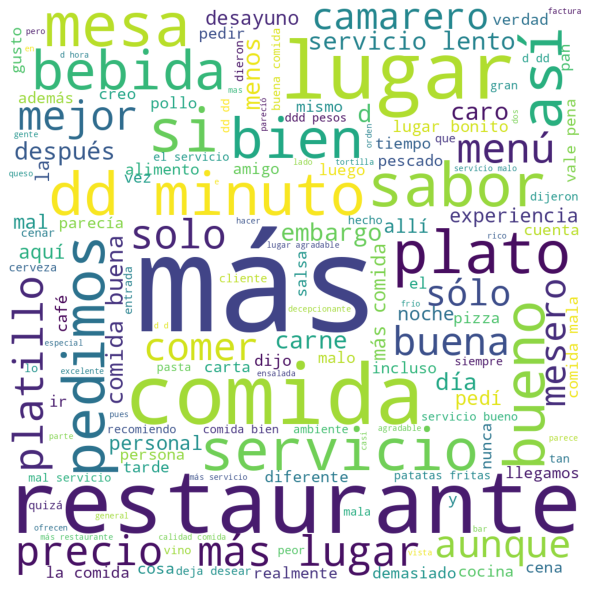

2.0-Hotel


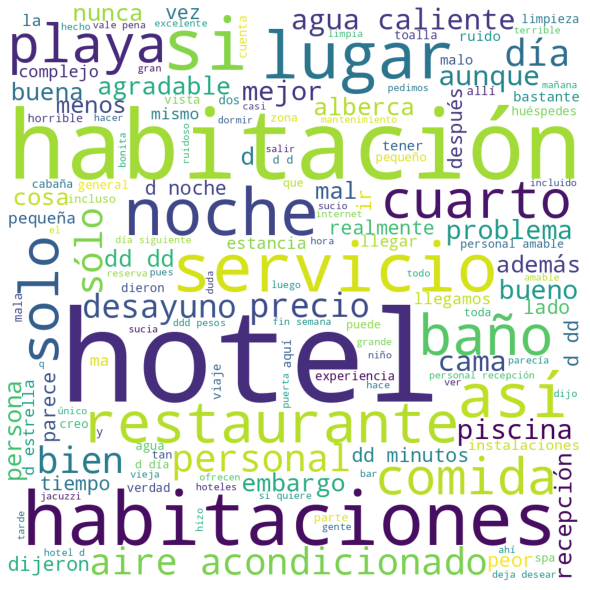

3.0-Attractive


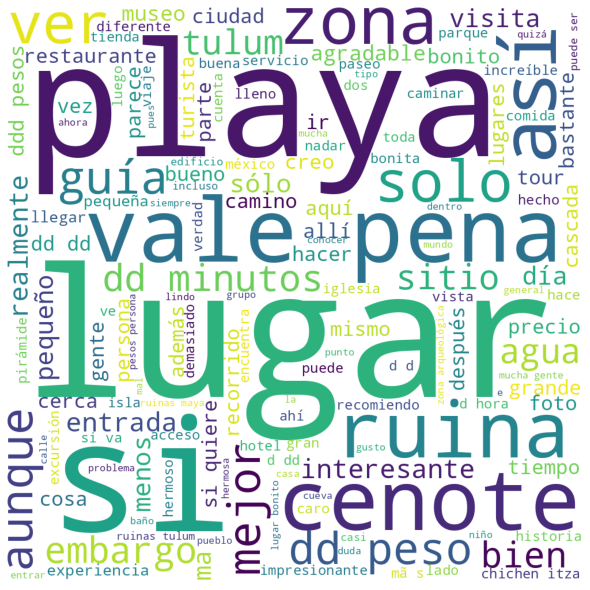

3.0-Restaurant


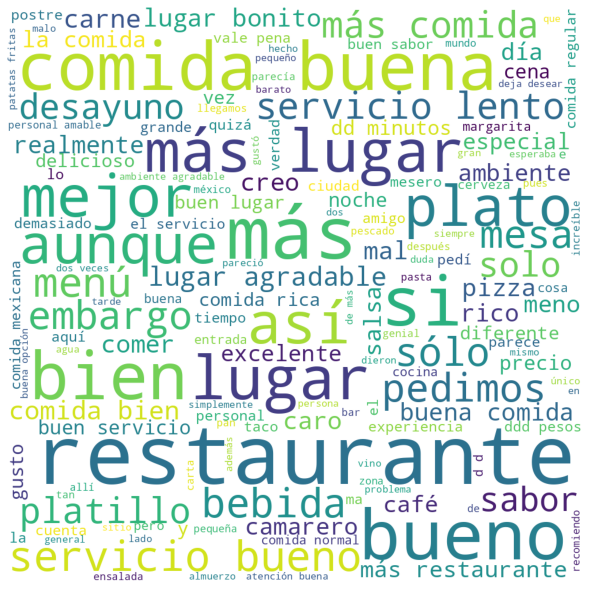

3.0-Hotel


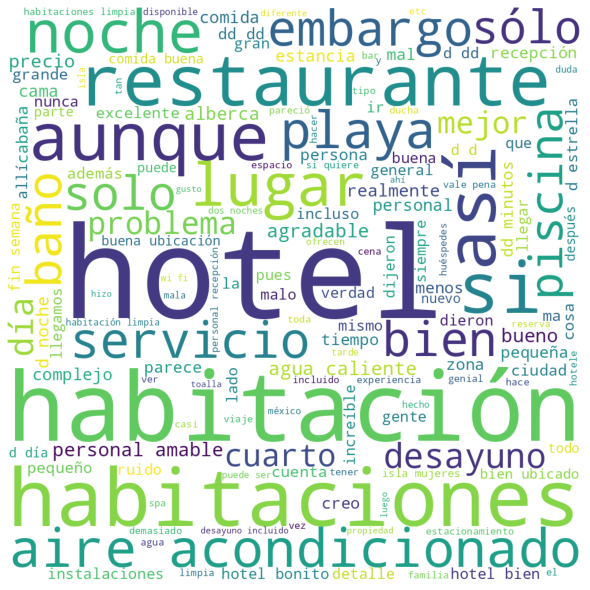

4.0-Attractive


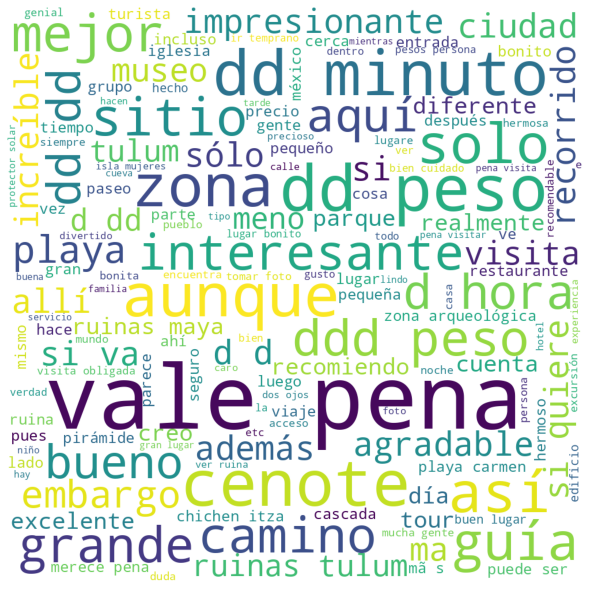

4.0-Restaurant


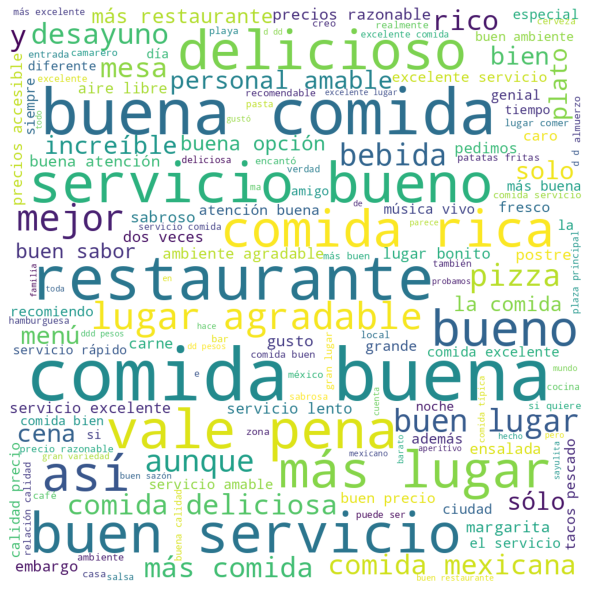

4.0-Hotel


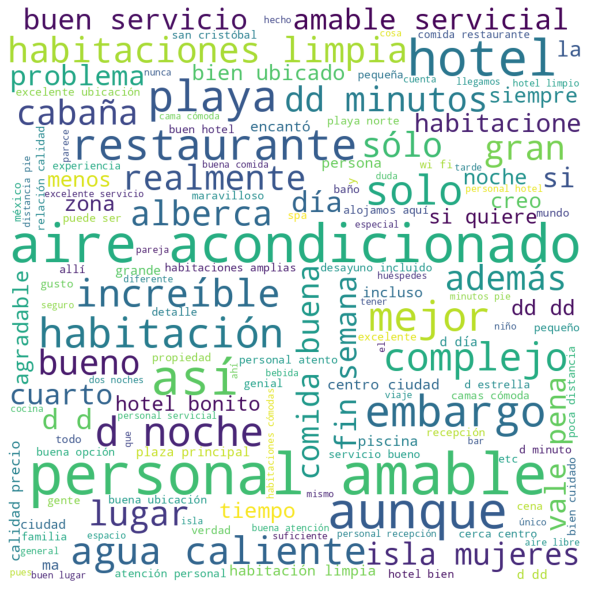

5.0-Attractive


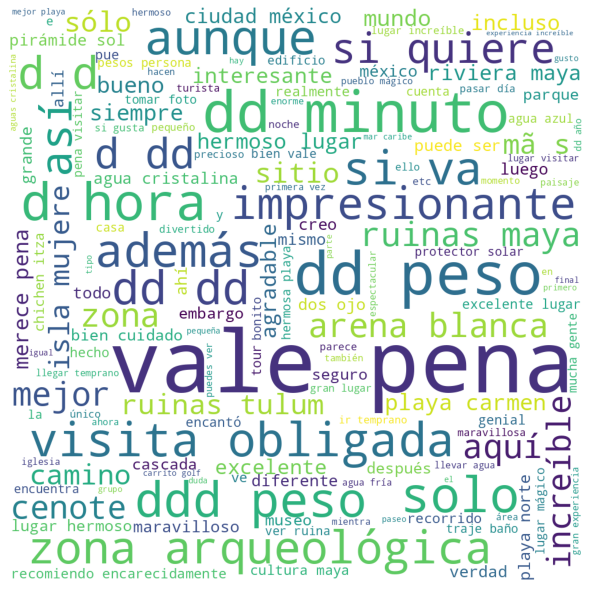

5.0-Restaurant


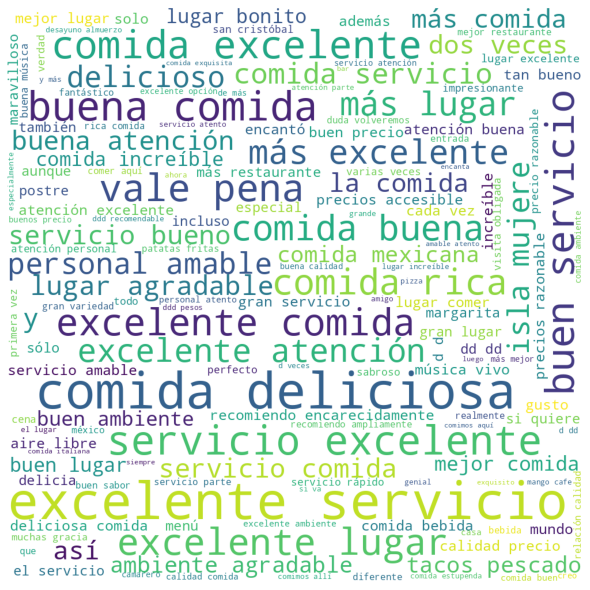

5.0-Hotel


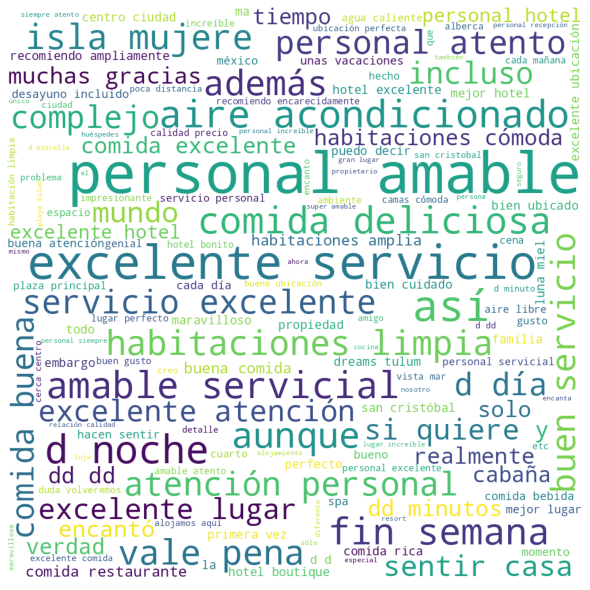

In [ ]:
nubesdePalabrasPorSubClase(datosPueblosMagicos)

In [ ]:
def pueblosParaClasificar(datosPueblosMagicos):

  atractivos = datosPueblosMagicos[datosPueblosMagicos['Tipo'] == 'Attractive'];

  pueblosDisponibles = list(set(atractivos['Pueblo']));
  pueblosPromedio = []
  for town in pueblosDisponibles:
    pueblosPromedio.append([town, len(atractivos[atractivos['Pueblo'] == town])]);

  pueblosPromedio  = sorted(pueblosPromedio, key=lambda x: -x[1])
  resultados = []
  for i in range(len(pueblosPromedio)):
    if pueblosPromedio[i][1] >= 100:
      resultados.append(pueblosPromedio[i][0]);
  return resultados;



## Topical analysis with Bertopic

In [ ]:
!pip install bertopic

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 120.7/120.7 KB 3.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.2/5.2 MB 40.5 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 86.0/86.0 KB 8.6 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 88.2/88.2 KB 4.9 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 6.8/6.8 MB 59.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 63.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 199.8/199.8 KB 17.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 45.0 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     

In [ ]:
from bertopic import BERTopic

topic_model = BERTopic(language="multilingual", calculate_probabilities=True, verbose=True)


In [ ]:
combinacion = datosPueblosMagicos[datosPueblosMagicos['Calificacion']==1.0]
#combinacion = combinacion[combinacion['Tipo']== 'Attractive'];


In [ ]:
len(combinacion)

8243

In [ ]:
def limpiaTexto(textos):

  texto_limpio = []
  for t in textos:
    t = preprocess(text=t, removeStopWords=True);
    texto_limpio.append(" ".join(t));
  return texto_limpio;

In [ ]:
textos_limpios = limpiaTexto(combinacion['Review'])

In [ ]:
#topics, probs = topic_model.fit_transform(list(combinacion['Review']));
topics, probs = topic_model.fit_transform(textos_limpios);

Batches:   0%|          | 0/258 [00:00<?, ?it/s]

2023-03-22 16:32:51,541 - BERTopic - Transformed documents to Embeddings
2023-03-22 16:33:37,060 - BERTopic - Reduced dimensionality
2023-03-22 16:33:39,509 - BERTopic - Clustered reduced embeddings


In [ ]:
freq = topic_model.get_topic_info();

In [ ]:
freq.head(20)

,Topic,Count,Name
0,-1,4890,-1_lugar_hotel_dd_servicio
1,0,267,0_comida_servicio_mala_pésimo
2,1,210,1_reserva_hotel_tarjeta_reservación
3,2,167,2_toallas_baño_habitación_habitaciones
4,3,153,3_pesos_dd_hotel_ddd
5,4,143,4_servicio_meseros_atención_pésimo
6,5,138,5_sopa_sabor_salsa_ensalada
7,6,130,6_playa_isla_hotel_habitación
8,7,99,7_habitación_día_noche_dd
9,8,98,8_lugar_pirámide_turistas_ruinas


In [ ]:
for i in range(20):
  print(f"Topico {i}")
  print(topic_model.get_topic(i))

Topico 0
[('comida', 0.04923339868890931), ('servicio', 0.043883397195328064), ('mala', 0.030490708058958566), ('pésimo', 0.026998609273500864), ('alimentos', 0.02624279857096151), ('mal', 0.023668921522920328), ('calidad', 0.023084528158956938), ('lugar', 0.01967668251629212), ('más', 0.018355169542167964), ('lento', 0.018242830951094524)]
Topico 1
[('reserva', 0.03601730114076812), ('hotel', 0.022842894190421622), ('tarjeta', 0.021575012565683283), ('reservación', 0.021530456627760666), ('correo', 0.017568240509603254), ('dd', 0.015037628600804962), ('booking', 0.014795334510079968), ('dijeron', 0.014596164934561302), ('electrónico', 0.012848579969279971), ('hice', 0.01284808728163213)]
Topico 2
[('toallas', 0.02707087758289575), ('baño', 0.023915870807563487), ('habitación', 0.02350640462115355), ('habitaciones', 0.02286218977308389), ('hotel', 0.022776514093807737), ('aire', 0.017699579436675373), ('agua', 0.017322789053576017), ('sábanas', 0.016238558530252287), ('viejo', 0.015643

In [ ]:
topic_model.visualize_topics()

In [ ]:
topic_model.visualize_barchart(top_n_topics=20)

In [ ]:
combinacion = datosPueblosMagicos[datosPueblosMagicos['Calificacion']==5.0]
combinacion = combinacion[combinacion['Tipo']== 'Attractive'];
len(combinacion)

70302

In [ ]:
textos_limpios = limpiaTexto(combinacion['Review'])

In [ ]:
topics, probs = topic_model.fit_transform(textos_limpios);

Batches:   0%|          | 0/2197 [00:00<?, ?it/s]

2023-03-22 18:08:25,429 - BERTopic - Transformed documents to Embeddings
2023-03-22 18:10:02,404 - BERTopic - Reduced dimensionality
2023-03-22 18:21:15,677 - BERTopic - Clustered reduced embeddings


In [ ]:
freq = topic_model.get_topic_info();

In [ ]:
freq.head(20)

,Topic,Count,Name
0,-1,31729,-1_dd_lugar_agua_playa
1,0,5385,0_maya_mayas_ruinas_riviera
2,1,2336,1_pirámide_pirámides_luna_subir
3,2,1768,2_iglesia_catedral_iglesias_taxco
4,3,1298,3_tulum_ruinas_playa_mar
5,4,1033,4_sillas_playa_bebidas_comida
6,5,921,5_museo_piezas_ámbar_museos
7,6,763,6_cuevas_cueva_buceo_murciélagos
8,7,705,7_iguanas_iguana_ruinas_vistas
9,8,686,8_laguna_colores_agua_lancha


In [ ]:
for i in range(20):
  print(f"Topico {i}")
  print(topic_model.get_topic(i))

Topico 0
[('maya', 0.016460359577234605), ('mayas', 0.013631125494090509), ('ruinas', 0.007896256741924321), ('riviera', 0.00785212758912446), ('tulum', 0.006529680850156664), ('cultura', 0.006338642384009064), ('mar', 0.004840546391974859), ('guía', 0.004344563862430742), ('caribe', 0.004145136730174072), ('historia', 0.0040874228820256785)]
Topico 1
[('pirámide', 0.023059033535634873), ('pirámides', 0.021544156557265902), ('luna', 0.015767543879332383), ('subir', 0.014883661964496276), ('sol', 0.013429267617188838), ('cima', 0.01008528820597731), ('piramide', 0.008985502897555052), ('teotihuacan', 0.008210502706646345), ('piramides', 0.008050717393681071), ('muertos', 0.005835310358278782)]
Topico 2
[('iglesia', 0.0493385222034814), ('catedral', 0.02737713107533678), ('iglesias', 0.015735735487965957), ('taxco', 0.011874944682268764), ('barroco', 0.011618915389085157), ('interior', 0.011421982107120697), ('fachada', 0.009504397907798775), ('prisca', 0.00930549099180896), ('santa', 0.

In [ ]:
topic_model.visualize_topics()

In [ ]:
topic_model.visualize_barchart(top_n_topics=20)

# Top 10


*   QuintanaRoo
*   Chiapas
*   Estado_de_Mexico
*   Yucatan
*   Jalisco
*   Baja_CaliforniaSur
*   Nayarit
*   Puebla
*   Queretaro
*   Michoacan



In [ ]:
def topicosPorEstado(e, k = 10):

  textos = datosPueblosMagicos[datosPueblosMagicos['Estado'] == e]
  textos = textos[textos['Tipo'] == 'Attractive']

  print(e);
  textos_limpios = limpiaTexto(textos['Review'])
  topics, probs = topic_model.fit_transform(textos_limpios);
  freq = topic_model.get_topic_info();
  for i in range(k):
    print(f"Topico {i}")
    try:
      print(topic_model.get_topic(i))
    except:
      print(f"No hay topico {i}")

  return topic_model;



In [ ]:
estados = sorted(list(set(datosPueblosMagicos['Estado'])));
topic_model = topicosPorEstado('Puebla', 20)
#topic_model.visualize_topics()


Puebla


Batches:   0%|          | 0/133 [00:00<?, ?it/s]

2023-03-22 20:55:05,477 - BERTopic - Transformed documents to Embeddings
2023-03-22 20:55:18,349 - BERTopic - Reduced dimensionality
2023-03-22 20:55:19,050 - BERTopic - Clustered reduced embeddings


Topico 0
[('iglesia', 0.040693926032270566), ('barroco', 0.02004595073242952), ('iglesias', 0.017609485166229216), ('indígenas', 0.016889204100477364), ('indígena', 0.01475504757949461), ('puebla', 0.014748493026859448), ('interior', 0.014557786518916399), ('arte', 0.013423726436810828), ('estilo', 0.01148093715433306), ('pena', 0.011417191471004057)]
Topico 1
[('cascada', 0.04413796372564374), ('cascadas', 0.031202628712725), ('agua', 0.02636550236377635), ('llegar', 0.018743576305050903), ('puente', 0.01873706833839865), ('camino', 0.01805539652182577), ('parque', 0.017889816220530496), ('ddd', 0.01754487479420456), ('tirolesa', 0.016717894373833045), ('lugar', 0.016301517787299602)]
Topico 2
[('relojes', 0.11372800428260478), ('museo', 0.06071451944866437), ('reloj', 0.04537386582276938), ('autómatas', 0.0422547368060838), ('monumentales', 0.037870007215871734), ('fábrica', 0.034570154572600126), ('espectáculo', 0.03314716694019591), ('show', 0.029776803310304276), ('historia', 0.02

In [ ]:
topic_model.visualize_topics()

In [ ]:
topic_model.visualize_barchart(top_n_topics=20)

In [ ]:
topic_model = topicosPorEstado('Michoacan', 20)

Michoacan


Batches:   0%|          | 0/72 [00:00<?, ?it/s]

2023-03-23 16:24:22,812 - BERTopic - Transformed documents to Embeddings
2023-03-23 16:24:49,266 - BERTopic - Reduced dimensionality
2023-03-23 16:24:49,575 - BERTopic - Clustered reduced embeddings


Topico 0
[('iglesia', 0.05631447817091125), ('salud', 0.044820987973477264), ('virgen', 0.04465555407307364), ('basílica', 0.0274879529961929), ('templo', 0.02638344581644658), ('hermosa', 0.019862528596878894), ('convento', 0.01960529835798832), ('catedral', 0.019256697373540403), ('interior', 0.019107485909094057), ('manto', 0.018432783564576897)]
Topico 1
[('cobre', 0.12278040749456329), ('piezas', 0.041479674489305056), ('clara', 0.03465925902832563), ('santa', 0.033413481411119494), ('pueblo', 0.02313293685538194), ('talleres', 0.022646361981924237), ('ver', 0.02212673664992024), ('artesanos', 0.021880236327373646), ('taller', 0.018143313024400236), ('trabajo', 0.018142698958363027)]
Topico 2
[('comida', 0.05787677673124313), ('cobre', 0.03101293945521052), ('carnitas', 0.028005970976378643), ('lugar', 0.02479430551551124), ('tostada', 0.02464422906307267), ('comer', 0.020778698615286424), ('tortas', 0.02053772561922787), ('buena', 0.02030859553096828), ('plaza', 0.019320932978827

In [ ]:
topic_model.visualize_topics()

In [ ]:
topic_model.visualize_barchart(top_n_topics=20)

In [ ]:
topic_model = topicosPorEstado('Queretaro', 20)

Queretaro


Batches:   0%|          | 0/48 [00:00<?, ?it/s]

2023-03-23 16:30:43,727 - BERTopic - Transformed documents to Embeddings
2023-03-23 16:30:53,943 - BERTopic - Reduced dimensionality
2023-03-23 16:30:54,066 - BERTopic - Clustered reduced embeddings


Topico 0
[('experiencia', 0.049530000387317745), ('temazcal', 0.04395048053953118), ('atención', 0.03197491342609324), ('excelente', 0.030942652004962972), ('antonio', 0.02798743805868605), ('servicio', 0.026258052223908958), ('josé', 0.021008903027601635), ('recomendable', 0.0194964020900084), ('gracias', 0.018242257672168954), ('lugar', 0.01789295170572595)]
Topico 1
[('plaza', 0.0706379261244005), ('restaurantes', 0.054492373835353415), ('tiendas', 0.050492731437054884), ('artesanías', 0.040073037413808854), ('lugar', 0.033513640871177613), ('calles', 0.03178190407328052), ('comer', 0.029956442176017742), ('centro', 0.029770666887260967), ('pasar', 0.027572438923608687), ('pueblo', 0.027017206385739217)]
Topico 2
[('agua', 0.07009362103327015), ('puente', 0.044924912028511024), ('río', 0.044049426565925094), ('llegar', 0.043280221639533295), ('dios', 0.03864174992188596), ('pena', 0.029213815156171812), ('lugar', 0.028954316833397456), ('camino', 0.0275109661765395), ('vale', 0.0253

In [ ]:
topic_model.visualize_topics()

In [ ]:
topic_model.visualize_barchart(top_n_topics=20)

In [ ]:
topic_model = topicosPorEstado('Nayarit', 20)

Nayarit


Batches:   0%|          | 0/66 [00:00<?, ?it/s]

2023-03-23 16:38:05,340 - BERTopic - Transformed documents to Embeddings
2023-03-23 16:38:18,087 - BERTopic - Reduced dimensionality
2023-03-23 16:38:18,236 - BERTopic - Clustered reduced embeddings


Topico 0
[('playa', 0.07099795372362605), ('sayulita', 0.0386970848206669), ('lugar', 0.03261380877863007), ('mã', 0.03026260246633936), ('surf', 0.028313069547545453), ('si', 0.02829740273337519), ('gente', 0.02698424826512081), ('ciudad', 0.024928714560493306), ('estã', 0.0235365843850492), ('dd', 0.02326418617564578)]
Topico 1
[('perros', 0.13195977625359764), ('playa', 0.08037772257134235), ('olas', 0.043405385475525714), ('vendedores', 0.038594077428597474), ('arena', 0.03561852595779555), ('perro', 0.03427183051563179), ('si', 0.0312290178826236), ('callejeros', 0.030693593992722788), ('playas', 0.030482232108009565), ('asã', 0.029592052845559574)]
Topico 2
[('tortugas', 0.2063027608945187), ('playa', 0.11721951609721575), ('liberaciã³n', 0.09053760646708317), ('mar', 0.050491955237998966), ('comida', 0.04957580484982539), ('encantã³', 0.045657997290858794), ('liberar', 0.043086980451172006), ('ver', 0.04224727139806195), ('montã³n', 0.04042651440037133), ('medusas', 0.0388018313

In [ ]:
topic_model.visualize_topics()

In [ ]:
topic_model.visualize_barchart(top_n_topics=20)

In [ ]:
topic_model = topicosPorEstado('Baja_CaliforniaSur', 20)

Baja_CaliforniaSur


Batches:   0%|          | 0/123 [00:00<?, ?it/s]

2023-03-23 16:45:02,253 - BERTopic - Transformed documents to Embeddings
2023-03-23 16:45:31,494 - BERTopic - Reduced dimensionality
2023-03-23 16:45:32,139 - BERTopic - Clustered reduced embeddings


Topico 0
[('playa', 0.06653556613600721), ('surf', 0.03700267158673477), ('olas', 0.025016033591998502), ('nadar', 0.021655623103039878), ('cerritos', 0.021060370130587484), ('restaurante', 0.020359742535628316), ('lugar', 0.01891701098982053), ('si', 0.017147892463489797), ('puede', 0.016493584221639917), ('tablas', 0.015937755213463498)]
Topico 1
[('misión', 0.06369144305907201), ('carretera', 0.03454024262373119), ('coche', 0.0314999436686145), ('viaje', 0.022633980055401556), ('pena', 0.022217216435610723), ('javier', 0.021790463573954665), ('san', 0.02078398909982866), ('montañas', 0.020671846579533082), ('camino', 0.019209050427718345), ('vale', 0.018923525701933133)]
Topico 2
[('masaje', 0.07897849577490455), ('spa', 0.060334936582174294), ('masajes', 0.050183103612454975), ('facial', 0.02768424726691851), ('agnes', 0.026247303937593117), ('flores', 0.025421399592862434), ('heidy', 0.02328723787689778), ('boutique', 0.022975863454079752), ('relajante', 0.021585246746259504), ('t

In [ ]:
topic_model.visualize_topics()

In [ ]:
topic_model.visualize_barchart(top_n_topics=20)

In [ ]:
topic_model = topicosPorEstado('Jalisco', 20)

Batches:   0%|          | 0/109 [00:00<?, ?it/s]

2023-03-23 16:54:20,108 - BERTopic - Transformed documents to Embeddings
2023-03-23 16:54:43,597 - BERTopic - Reduced dimensionality
2023-03-23 16:54:44,206 - BERTopic - Clustered reduced embeddings


Topico 0
[('cascada', 0.039140688246519284), ('llegar', 0.030144814277235147), ('camino', 0.030123264563791937), ('subir', 0.02338221270677772), ('dd', 0.02335070969817331), ('agua', 0.02289022607363189), ('si', 0.020335423673312297), ('subida', 0.01984562358788365), ('minutos', 0.018110595033229683), ('pena', 0.015874152812901804)]
Topico 1
[('lugar', 0.04063774200184793), ('tranquilo', 0.030206914352609845), ('caminar', 0.0291879241439806), ('gente', 0.023490503007643406), ('bonito', 0.021362621641741894), ('semana', 0.02098712793309462), ('familia', 0.02050225049314105), ('mañana', 0.019845522573364586), ('familias', 0.01940039115487775), ('ambiente', 0.019111026997351604)]
Topico 2
[('tiendas', 0.08043048091524443), ('restaurantes', 0.059882940478728816), ('galerías', 0.04806557148642413), ('artesanías', 0.04098651878639368), ('calle', 0.04010103908465259), ('tlaquepaque', 0.03309024629298513), ('independencia', 0.02939566921817448), ('arte', 0.02847283236111747), ('peatonal', 0.02

In [ ]:
topic_model.visualize_topics()

In [ ]:
topic_model.visualize_barchart(top_n_topics=20)

In [ ]:
topic_model = topicosPorEstado('Yucatan', 20)

Yucatan


Batches:   0%|          | 0/160 [00:00<?, ?it/s]

2023-03-23 17:00:46,076 - BERTopic - Transformed documents to Embeddings
2023-03-23 17:01:23,701 - BERTopic - Reduced dimensionality
2023-03-23 17:01:24,952 - BERTopic - Clustered reduced embeddings


Topico 0
[('arte', 0.04017563063692202), ('casa', 0.039881552382403686), ('mexicano', 0.032048556645417794), ('colección', 0.02782784646580328), ('méxico', 0.019250929627398324), ('popular', 0.01836841721275284), ('venados', 0.01598184292850606), ('piezas', 0.015356911837667362), ('dd', 0.014715924707731073), ('propietarios', 0.0138705114104963)]
Topico 1
[('casa', 0.036514713992200645), ('arte', 0.030997937210683068), ('colección', 0.03018795145575773), ('museo', 0.026904044741470304), ('piezas', 0.019415728429235498), ('privada', 0.015188496819786226), ('increíble', 0.014090112434837251), ('cada', 0.013974279185872367), ('guía', 0.013757075365560862), ('excursión', 0.01353149882073932)]
Topico 2
[('maya', 0.03771479655715596), ('cenote', 0.019756173327239702), ('experiencia', 0.014479676270073655), ('mayas', 0.013853725025843804), ('agua', 0.013032727424649124), ('comida', 0.011050619937820551), ('guía', 0.010821136835001365), ('cultura', 0.01057863192075222), ('viaje', 0.01014231883

In [ ]:
topic_model.visualize_topics()

In [ ]:
topic_model.visualize_barchart(top_n_topics=20)

In [ ]:
topic_model = topicosPorEstado('Estado_de_Mexico', 20)

Estado_de_Mexico


Batches:   0%|          | 0/282 [00:00<?, ?it/s]

2023-03-23 17:12:30,103 - BERTopic - Transformed documents to Embeddings
2023-03-23 17:12:51,806 - BERTopic - Reduced dimensionality
2023-03-23 17:12:54,922 - BERTopic - Clustered reduced embeddings


Topico 0
[('teotihuacan', 0.02857351234184032), ('teotihuacán', 0.02197512328965677), ('pirámide', 0.015478977179638517), ('sol', 0.013524418484029953), ('pirámides', 0.012607198346107221), ('luna', 0.012355784005234922), ('subir', 0.009982715011734434), ('cultura', 0.009510329905492651), ('visitar', 0.008774442260155496), ('zona', 0.008521155220988225)]
Topico 1
[('pirámides', 0.015932988172203), ('tour', 0.011966053867045277), ('pirámide', 0.011949412553878887), ('sol', 0.011598597111298597), ('vendedores', 0.011214529611597295), ('luna', 0.010307603785448706), ('subir', 0.009262586774361052), ('tiempo', 0.008643126463998757), ('guía', 0.00840601634588043), ('sitio', 0.008279647099003041)]
Topico 2
[('méxico', 0.0326700137195503), ('ciudad', 0.022309669654691486), ('historia', 0.017443266813486707), ('mexico', 0.016479844096914192), ('visita', 0.014773023847652472), ('cultura', 0.013192749587694834), ('lugar', 0.012688026689229862), ('mexicanos', 0.012059266092338893), ('mexicana', 0

In [ ]:
topic_model.visualize_topics()

In [ ]:
topic_model.visualize_barchart(top_n_topics=20)

In [ ]:
topic_model = topicosPorEstado('Chiapas', 20)

Chiapas


Batches:   0%|          | 0/322 [00:00<?, ?it/s]

2023-03-23 17:25:04,099 - BERTopic - Transformed documents to Embeddings
2023-03-23 17:25:18,527 - BERTopic - Reduced dimensionality
2023-03-23 17:25:22,026 - BERTopic - Clustered reduced embeddings


Topico 0
[('maya', 0.03742554836623936), ('mayas', 0.02349293055172523), ('cultura', 0.017522360896591697), ('palenque', 0.016660772404927117), ('ruinas', 0.015443648690835933), ('sitio', 0.012741663395078383), ('guía', 0.01241558789354888), ('selva', 0.011684641546126286), ('ciudad', 0.010585010826273304), ('historia', 0.010578015452531278)]
Topico 1
[('animales', 0.0628846274259139), ('estã', 0.03332206170692624), ('mã', 0.029437959628866375), ('parque', 0.024521232018207474), ('manatã', 0.02280928265130552), ('os', 0.020810864968840496), ('especies', 0.01852804073695984), ('aluxes', 0.01848969649437019), ('alimentar', 0.018078700060881144), ('guacamayas', 0.016771455333583964)]
Topico 2
[('azul', 0.06708191370680847), ('agua', 0.04708751210780855), ('cascadas', 0.037449737935695226), ('color', 0.02905072170721028), ('nadar', 0.01875364075671809), ('azules', 0.017420435175609893), ('lluvias', 0.016778509337974735), ('aguas', 0.014489262926729644), ('temporada', 0.011373869501067968),

In [ ]:
topic_model.visualize_topics()

In [ ]:
topic_model.visualize_barchart(top_n_topics=20)

In [ ]:
topic_model = topicosPorEstado('QuintanaRoo', 20)

QuintanaRoo


Batches:   0%|          | 0/1499 [00:00<?, ?it/s]

2023-03-23 18:22:15,878 - BERTopic - Transformed documents to Embeddings
2023-03-23 18:23:18,633 - BERTopic - Reduced dimensionality
2023-03-23 18:25:23,248 - BERTopic - Clustered reduced embeddings


Topico 0
[('tulum', 0.018542540591609227), ('ruinas', 0.009445398689249708), ('visita', 0.006342070130466482), ('visitar', 0.006002083029954268), ('excursión', 0.005664231565278849), ('tiempo', 0.0055946264863516865), ('si', 0.005288466826803969), ('día', 0.0051349312408799095), ('guía', 0.005120649959092957), ('playa', 0.005096317604247197)]
Topico 1
[('mar', 0.01400507846028408), ('ruinas', 0.012801327979002845), ('vista', 0.009777375251242752), ('vistas', 0.009006501475840051), ('historia', 0.008652865488570482), ('playa', 0.008624463532437978), ('arqueológica', 0.008110972071260958), ('zona', 0.007631640442372589), ('lugar', 0.007109373213370941), ('océano', 0.006685529709370576)]
Topico 2
[('iguanas', 0.046634276660494654), ('iguana', 0.013640324658081697), ('montón', 0.008506374998978253), ('vistas', 0.008499464755437591), ('partes', 0.008361159185240725), ('muchas', 0.008103170551777672), ('ruinas', 0.007442322886642256), ('todas', 0.007237779183234391), ('sur', 0.00685966774232

In [ ]:
topic_model.visualize_topics()

In [ ]:
topic_model.visualize_barchart(top_n_topics=20)

## Important words

In [ ]:
from sklearn.preprocessing import LabelBinarizer
from sklearn.feature_selection import chi2, SelectKBest
from sklearn.feature_extraction.text import CountVectorizer


In [ ]:
# suppose we have the following toy text data
X = np.array(['futbol y tenis', 'futbol y otras cosas', 'tenis y otras cosas mas', 'carros y otras cosas', 'carros y otras cosas', 'y mas carros', 'otras cosas dinero'])
y = [1, 1, 1, 0, 0, 0, 2]

# we'll convert it to a dense document-term matrix,
# so we can print a more readable output
vect = CountVectorizer()
X_dtm = vect.fit_transform(X)
X_dtm = X_dtm.toarray()
pd.DataFrame(X_dtm, columns = vect.get_feature_names_out())

,carros,cosas,dinero,futbol,mas,otras,tenis
0,0,0,0,1,0,0,1
1,0,1,0,1,0,1,0
2,0,1,0,0,1,1,1
3,1,1,0,0,0,1,0
4,1,1,0,0,0,1,0
5,1,0,0,0,1,0,0
6,0,1,1,0,0,1,0


In [ ]:
y_binarized = LabelBinarizer().fit_transform(y)
print(y_binarized)
print()

# our observed count for each class (the row)
# and each feature (the column)
observed = np.dot(y_binarized.T, X_dtm)
print(observed)

[[0 1 0]
 [0 1 0]
 [0 1 0]
 [1 0 0]
 [1 0 0]
 [1 0 0]
 [0 0 1]]

[[3 2 0 0 1 2 0]
 [0 2 0 2 1 2 2]
 [0 1 1 0 0 1 0]]


In [ ]:
# compute the probability of each class and the feature count;
# keep both as a 2 dimension array using reshape
class_prob = y_binarized.mean(axis = 0).reshape(1, -1)
feature_count = X_dtm.sum(axis = 0).reshape(1, -1)
expected = np.dot(class_prob.T, feature_count)
print(expected)

[[1.28571429 2.14285714 0.42857143 0.85714286 0.85714286 2.14285714
  0.85714286]
 [1.28571429 2.14285714 0.42857143 0.85714286 0.85714286 2.14285714
  0.85714286]
 [0.42857143 0.71428571 0.14285714 0.28571429 0.28571429 0.71428571
  0.28571429]]


In [ ]:
chisq = (observed - expected) ** 2 / expected
chisq_score = chisq.sum(axis = 0)
print(chisq_score)

[4.         0.13333333 6.         2.66666667 0.33333333 0.13333333
 2.66666667]


In [ ]:
np.array(chisq_score).reshape(7,1)

array([[4.        ],
       [0.13333333],
       [6.        ],
       [2.66666667],
       [0.33333333],
       [0.13333333],
       [2.66666667]])

In [ ]:
vect.get_feature_names_out().shape

(7,)

In [ ]:
datos = np.concatenate((np.array(chisq_score).reshape(7,1), vect.get_feature_names_out().reshape(7,1)), axis=1)

sorted(datos, key=lambda x: -x[0])

[array([6.000000000000001, 'dinero'], dtype=object),
 array([4.000000000000001, 'carros'], dtype=object),
 array([2.6666666666666665, 'futbol'], dtype=object),
 array([2.6666666666666665, 'tenis'], dtype=object),
 array([0.33333333333333337, 'mas'], dtype=object),
 array([0.1333333333333334, 'cosas'], dtype=object),
 array([0.1333333333333334, 'otras'], dtype=object)]

In [ ]:
chi2score = chi2(X_dtm, y)
chi2score

(array([4.        , 0.13333333, 6.        , 2.66666667, 0.33333333,
        0.13333333, 2.66666667]),
 array([0.13533528, 0.93550699, 0.04978707, 0.26359714, 0.84648172,
        0.93550699, 0.26359714]))

In [ ]:
kbest = SelectKBest(score_func = chi2, k = 2)
X_dtm_kbest = kbest.fit_transform(X_dtm, y)
X_dtm_kbest

array([[0, 0],
       [0, 0],
       [0, 0],
       [1, 0],
       [1, 0],
       [1, 0],
       [0, 1]])

In [ ]:
def palabrasImportantes(datosPueblosMagicos, filtraEstado = True,estado = 'Puebla', filtraTipo = False, tipo = 'Attractive', filtraCalificacion = False, calificacion = 1.0, clasesPositivas = [5.0, 4.0], ClasesNegativas = [1.0,2.0,3.0]):

  datos = datosPueblosMagicos;

  if filtraEstado:
    datos = datos[datos['Estado'] == estado];
  if filtraTipo:
    datos = datos[datos['Tipo'] == tipo];
  if filtraCalificacion:
    datos = datos[datos['Calificacion'] == calificacion];

  textos = datos['Review'];
  textos_limpios = []
  y = [];

  for i in range(len(datos)):

    if (datos['Calificacion'].iloc[i] in clasesPositivas) or (datos['Calificacion'].iloc[i] in ClasesNegativas):
      #print(datos['Review'].iloc[i])
      textos_limpios.append(" ".join(preprocess(datos['Review'].iloc[i], removeStopWords=True, stem=True)));
      if datos['Calificacion'].iloc[i] in ClasesNegativas:
        y.append(0);
      else:
        y.append(1);
    print(f"{i+1}/{len(datos)}")


  vect = CountVectorizer()
  X = np.array(textos_limpios);
  #print(textos_limpios[:10])
  X_dtm = vect.fit_transform(X)
  X_dtm = X_dtm.toarray()
  y_binarized = LabelBinarizer().fit_transform(y)
  observed = np.dot(y_binarized.T, X_dtm)
  class_prob = y_binarized.mean(axis = 0).reshape(1, -1)
  feature_count = X_dtm.sum(axis = 0).reshape(1, -1)
  expected = np.dot(class_prob.T, feature_count)
  chisq = (observed - expected) ** 2 / expected
  chisq_score = chisq.sum(axis = 0)
  palabras_importantes = np.concatenate((np.array(chisq_score).reshape(len(chisq_score),1), vect.get_feature_names_out().reshape(len(chisq_score),1)), axis=1);
  palabras_importantes = sorted(palabras_importantes, key=lambda x: -x[0])
  return palabras_importantes;


def palabrasImportantesPueblos(datosPueblosMagicosEstadosFinales, pueblosFinales, minrep = 50, stemFlag= False, importantFlag = False, importantWords = []):


  textos = list(datosPueblosMagicosEstadosFinales['Review']);

  textos_limpios, voc = preprocessText(textos, minrep = minrep, stemFlag=stemFlag, importantFlag=importantFlag, importantWords=importantWords);
  y = [];

  for i in range(len(datosPueblosMagicosEstadosFinales)):

    y.append(pueblosFinales.index(datosPueblosMagicosEstadosFinales['Pueblo'].iloc[i]));

  vect = CountVectorizer()
  X = np.array(textos_limpios);
  #print(textos_limpios[:10])
  X_dtm = vect.fit_transform(X)
  X_dtm = X_dtm.toarray()
  y_binarized = LabelBinarizer().fit_transform(y)
  observed = np.dot(y_binarized.T, X_dtm)
  class_prob = y_binarized.mean(axis = 0).reshape(1, -1)
  feature_count = X_dtm.sum(axis = 0).reshape(1, -1)
  expected = np.dot(class_prob.T, feature_count)
  chisq = (observed - expected) ** 2 / expected
  chisq_score = chisq.sum(axis = 0)
  palabras_importantes = np.concatenate((np.array(chisq_score).reshape(len(chisq_score),1), vect.get_feature_names_out().reshape(len(chisq_score),1)), axis=1);
  palabras_importantes = sorted(palabras_importantes, key=lambda x: -x[0])
  return palabras_importantes;


In [ ]:
palabras_importantes = palabrasImportantes(datosPueblosMagicos, filtraEstado=True, estado='NuevoLeon', filtraTipo=True, tipo='Attractive', clasesPositivas=[5.0], ClasesNegativas=[1.0])

In [ ]:
palabras_importantes[:200]

[array([3.8483412322274884, 'control'], dtype=object),
 array([2.8990141639439346, 'pues'], dtype=object),
 array([2.886255924170616, 'suci'], dtype=object),
 array([2.886255924170616, 'tall'], dtype=object),
 array([2.1081934489762566, 'alcohol'], dtype=object),
 array([2.1081934489762566, 'bas'], dtype=object),
 array([2.1081934489762566, 'basur'], dtype=object),
 array([2.1081934489762566, 'cervez'], dtype=object),
 array([1.9241706161137442, 'apest'], dtype=object),
 array([1.9241706161137442, 'cantin'], dtype=object),
 array([1.9241706161137442, 'exces'], dtype=object),
 array([1.9241706161137442, 'formulari'], dtype=object),
 array([1.9241706161137442, 'infiern'], dtype=object),
 array([1.9241706161137442, 'puntual'], dtype=object),
 array([1.9241706161137442, 'vergüenz'], dtype=object),
 array([1.9241706161137442, 'vip'], dtype=object),
 array([1.9241706161137442, 'volum'], dtype=object),
 array([1.64195363388042, 'mal'], dtype=object),
 array([1.3316251488338433, 'ningun'], dty

## Measuring the ease of the corpus

In [ ]:
textos = limpiaTexto(datosPueblosMagicos['Review']);


In [ ]:
polaridad = list(datosPueblosMagicos['Calificacion']);
atractivo = list(datosPueblosMagicos['Tipo']);

In [ ]:
c = dict()
c[1.0] = set()
c[2.0] = set()
c[3.0] = set()
c[4.0] = set()
c[5.0] = set()
c['Hotel'] = set()
c['Restaurant'] = set()
c['Attractive'] = set()

k = 0;
for text in textos:
  try:
    text = text.lower();
  except:
    text = "vacio"


  text = tokens(text);
  text = set(text);
  #print(text)
  #print(polaridad[k])
  claseP = polaridad[k];
  claseA = atractivo[k];

  c[claseP] |= text;
  c[claseA] |= text;
  k+=1;

In [ ]:
def facilidad(conjutnos):

  dificultadTotal = 0;
  denominador = 0;
  for i in range(len(conjuntos)):
    union = set()

    for j in range(len(conjuntos)):
      if j != i:
        union |= conjuntos[j];
    dificultadClase = len( conjuntos[i] - union );

    dificultadTotal += dificultadClase;
    denominador += len(conjuntos[i]);
    print(f'Longitud de la clase {i} = {len(conjuntos[i])}')
    print(f'Facilidad de la clase {i} = {dificultadClase}')
    print()


  print(f'Facilidad del corpus: {dificultadTotal}/{denominador} = {dificultadTotal / denominador}')

In [ ]:
conjuntos = [c[1.0] | c[2.0] | c[3.0], c[4.0] |c[5.0]];
conjuntos = [c['Hotel'], c['Restaurant'] | c['Attractive']];

In [ ]:
facilidad(conjuntos)

Longitud de la clase 0 = 68791
Facilidad de la clase 0 = 23695

Longitud de la clase 1 = 115399
Facilidad de la clase 1 = 70303

Facilidad del corpus: 93998/184190 = 0.5103317226776698


In [ ]:
pueblosFinales = pueblosParaClasificar(datosPueblosMagicos)

In [ ]:
pueblosFinales = pueblosFinales[5:10]

In [ ]:
pueblosFinales

['San_Cristobal_de_las_Casas', 'Bacalar', 'Taxco', 'Loreto', 'Cholula']

In [ ]:
def preprocessText(df, minrep = 1, bigramas = 0, stemFlag = True, importantFlag = False, importantWords = []):

  new_df = list();
  list_df = list()
  voc = list();
  rep = dict();
  h = 1;
  for text in df:

    text = text.lower();

    text = remove_punctuation_mark(text);

    text = remove_stop_words(text, language='spanish');

    if importantFlag:
      text = remove_not_important_words(text, importantWords);

    text = replace_digits(text);

    text = tokens(text);

    if stemFlag:
      text = [stemmer.stem(t) for t in text];
    if bigramas == 0:
      text =" ".join(text);
    elif bigramas == 1:
      text = get_bigramas(text);
    elif bigramas == 2:
      text =" ".join(text)+" " + get_bigramas(text);
    list_df.append(text);
    for t in text.split(" "):
      if not t in rep:
        rep[t] = 0;
      rep[t] += 1;

    print(str(h) + "/" +str(len(df)));
    h+=1;

  for text in list_df:
    text = remove_word_frec_lower(text, rep, minrep= minrep);
    new_df.append(text);
    voc += text.split(" ");

  voc = list(set(voc));
  voc.sort();

  return new_df, voc;


In [ ]:
def juntaPueblosParaCLasificar(datosPueblosMagicos, pueblosFinales):

  datosFinales = pd.DataFrame({"Author": [],
                    "Titulo": [],
                    "Review": [],
                    "Calificacion": [],
                    "OrigenAutor": [],
                    "FechaOpinion": [],
                    "FechaEstadia": [],
                    "Pueblo": [],
                    "Estado": [],
                    "Pais": [],
                    "Tipo": [],
                    "Lugar": []});
  lugar = [];
  for i in range(len(pueblosFinales)):

      datos = datosPueblosMagicos[datosPueblosMagicos['Pueblo'] == pueblosFinales[i]];
      datos = datos[datos['Tipo'] == 'Attractive']
      datosFinales = pd.concat([datosFinales, datos], axis=0)

      print(f"{i+1}/{len(pueblosFinales)}");


  datosFinales = datosFinales.drop(['Author','Titulo', 'Calificacion', 'OrigenAutor', 'FechaOpinion','FechaEstadia', 'Estado', 'Pais', 'Tipo', 'Lugar'],  axis=1);

  return datosFinales;




In [ ]:
datosClasificacionPorPueblosMagicos = juntaPueblosParaCLasificar(datosPueblosMagicos, pueblosFinales)

1/5
2/5
3/5
4/5
5/5


In [ ]:
datosClasificacionPorPueblosMagicos.head()

,Review,Pueblo
0,"LugarBonito en SanCris, para pasar un momento ...",San_Cristobal_de_las_Casas
1,Vayan con tiempo ya que es muyyyy disfrutable....,San_Cristobal_de_las_Casas
2,Donde compras el ticket para la entrada al mus...,San_Cristobal_de_las_Casas
3,El museo intenta a su manera exponer las rique...,San_Cristobal_de_las_Casas
4,Es un lugar muy especial que ayuda a difundir ...,San_Cristobal_de_las_Casas


In [ ]:
len(datosClasificacionPorPueblosMagicos)

13015

In [ ]:
pueblosFinales.index('Cholula')

4

In [ ]:
pueblosFinales[0]

'San_Cristobal_de_las_Casas'

In [ ]:
palabras_Importantes_Pueblo = palabrasImportantesPueblos(datosClasificacionPorPueblosMagicos, pueblosFinales, minrep = 100)

Se han truncado las últimas 5000 líneas del flujo de salida.
100608/105607
100609/105607
100610/105607
100611/105607
100612/105607
100613/105607
100614/105607
100615/105607
100616/105607
100617/105607
100618/105607
100619/105607
100620/105607
100621/105607
100622/105607
100623/105607
100624/105607
100625/105607
100626/105607
100627/105607
100628/105607
100629/105607
100630/105607
100631/105607
100632/105607
100633/105607
100634/105607
100635/105607
100636/105607
100637/105607
100638/105607
100639/105607
100640/105607
100641/105607
100642/105607
100643/105607
100644/105607
100645/105607
100646/105607
100647/105607
100648/105607
100649/105607
100650/105607
100651/105607
100652/105607
100653/105607
100654/105607
100655/105607
100656/105607
100657/105607
100658/105607
100659/105607
100660/105607
100661/105607
100662/105607
100663/105607
100664/105607
100665/105607
100666/105607
100667/105607
100668/105607
100669/105607
100670/105607
100671/105607
100672/105607
100673/105607
100674/105607
1

In [ ]:
len(palabras_Importantes_Pueblo)

3826

In [ ]:
list(np.array(palabras_Importantes_Pueblo)[:200, 1])

['playa',
 'the',
 'and',
 'taxco',
 'sayulita',
 'pirámide',
 'loreto',
 'iglesia',
 'cholula',
 'mã',
 'to',
 'surf',
 'misión',
 'of',
 'cobre',
 'was',
 'estã',
 'puebla',
 'we',
 'isla',
 'dã',
 'olas',
 'were',
 'in',
 'trip',
 'plata',
 'pequeã',
 'with',
 'os',
 'pátzcuaro',
 'catedral',
 'patzcuaro',
 'our',
 'buceo',
 'montã³n',
 'artesanías',
 'for',
 'plaza',
 'lago',
 'vallarta',
 'malecón',
 'on',
 'guides',
 'asã',
 'janitzio',
 'morelos',
 'mar',
 'surfistas',
 'túneles',
 'it',
 'delfines',
 'aquã',
 'prisca',
 'kayak',
 'this',
 'tambiã',
 'ballenas',
 'blue',
 'aã',
 'arena',
 'vendedores',
 'gente',
 'marina',
 'teleférico',
 'is',
 'piramide',
 'all',
 'patios',
 'allã',
 'day',
 'masaje',
 'javier',
 'that',
 'they',
 'coronado',
 'pozas',
 'peces',
 'had',
 'nation',
 'playas',
 'very',
 'iglesias',
 'estatua',
 'islas',
 'baja',
 'leones',
 'my',
 'as',
 'great',
 'whale',
 'puerto',
 'mina',
 'subir',
 'remedios',
 'nadar',
 'agua',
 'whales',
 'at',
 'us',
 'm

In [ ]:
nuevosTextosParaNubesPorPueblo, voc = preprocessText(datosClasificacionPorPueblosMagicos['Review'], minrep=30, stemFlag=False, importantFlag=True, importantWords=list(np.array(palabras_Importantes_Pueblo)[:2500, 1]));

Se han truncado las últimas 5000 líneas del flujo de salida.
100608/105607
100609/105607
100610/105607
100611/105607
100612/105607
100613/105607
100614/105607
100615/105607
100616/105607
100617/105607
100618/105607
100619/105607
100620/105607
100621/105607
100622/105607
100623/105607
100624/105607
100625/105607
100626/105607
100627/105607
100628/105607
100629/105607
100630/105607
100631/105607
100632/105607
100633/105607
100634/105607
100635/105607
100636/105607
100637/105607
100638/105607
100639/105607
100640/105607
100641/105607
100642/105607
100643/105607
100644/105607
100645/105607
100646/105607
100647/105607
100648/105607
100649/105607
100650/105607
100651/105607
100652/105607
100653/105607
100654/105607
100655/105607
100656/105607
100657/105607
100658/105607
100659/105607
100660/105607
100661/105607
100662/105607
100663/105607
100664/105607
100665/105607
100666/105607
100667/105607
100668/105607
100669/105607
100670/105607
100671/105607
100672/105607
100673/105607
100674/105607
1

In [ ]:
nuevosTextosParaNubesPorPueblo[:10]

['recomiendo llevar gorra sombrero vas soleado hace calor protector solar entrada persona solo puede pagar además llevar justo pueden tener además pagar entrar playa ejemplo entrada taquilla ofrecen visita guiada entrada superior podrás visitar cenotes esperar fila casi rápido visita dura aprox baños ofrecen guías carteles recorrido podrás ver muchas iguanas',
 'merece ser visitado ruinas podes ver mar paisaje extraordinario deben ingresar zona ruinas playas reserva natural precio ingresar ruinas',
 'dejar tipo tours forma general tours area tulum grupo llegar personas especialmente entrada cobran tour dólares bajan lancha llevan sitio tour lancha van ver mas bonito acceso sillas historia absolutamente lancha sucia mesas aun mas historia personas imagen país',
 'zona arqueológica contraste playas color azul turquesa hermoso imaginar cultura maya aquí puedes información pobladores',
 'zona arqueologica bonita orilla mar vistas ir temprano medio día llena rapido pueden tomar mucha gente 

In [ ]:
len(palabras_Importantes_Pueblo)

3830

In [ ]:
def nuebDePalabrasPorPuebloDiscriminado(textos_limpios, pueblos, pueblo = 'Cholula'):


  texto_limpio = ""
  for i in range(len(pueblos)):
    if pueblos[i] ==pueblo and textos_limpios[i]!="":
      texto_limpio += textos_limpios[i] + " ";

  word_cloud = WordCloud(height=1000, width=1000, background_color='white',max_words=150, min_font_size=5, collocation_threshold=10).generate(texto_limpio)

  #word_cloud.to_file("./img/ejemplo_sencillo.png") #Guardamos la imagen generada

  plt.figure(figsize=(10,8))
  plt.imshow(word_cloud)
  plt.axis('off')
  plt.tight_layout(pad=0)
  plt.show()


Ajiji


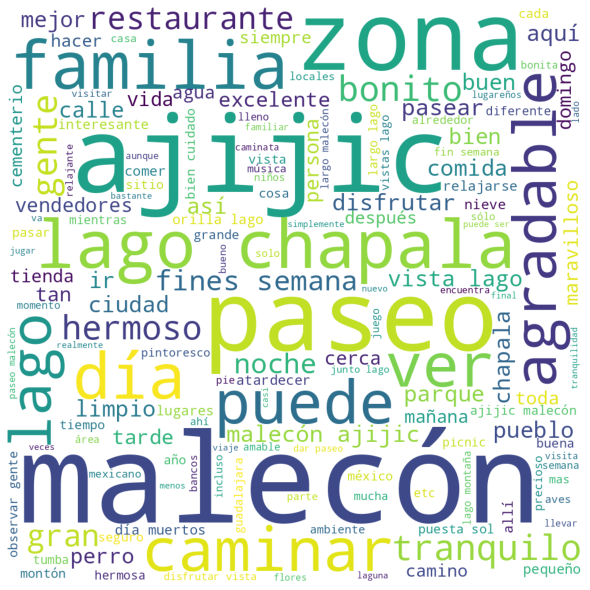

Aquismon


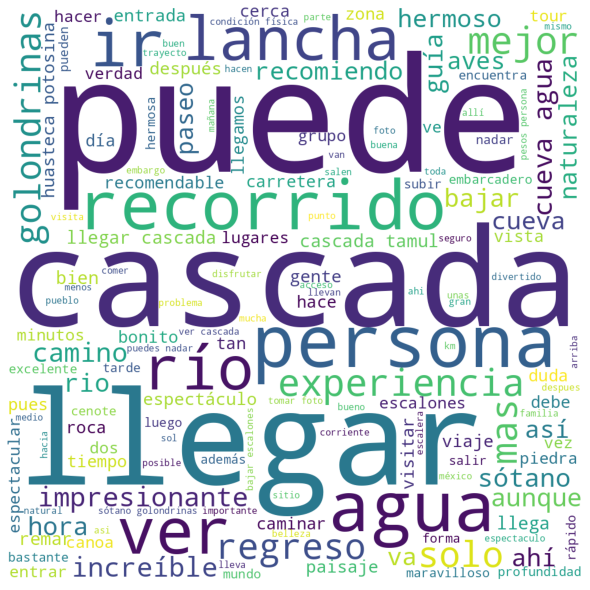

Atlixco


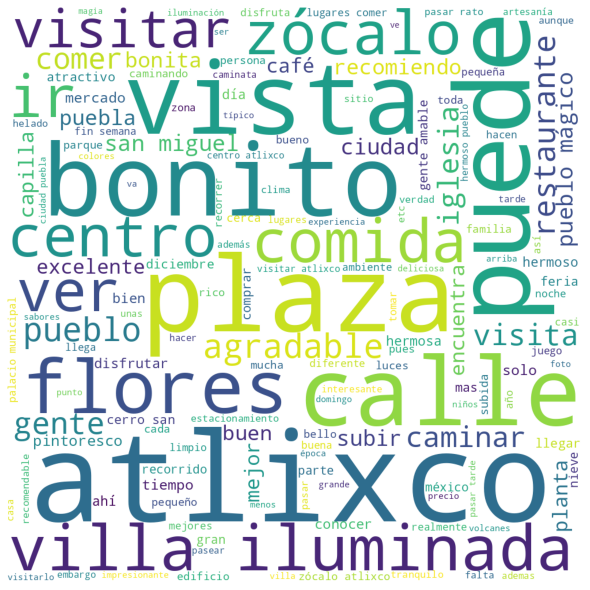

Bacalar


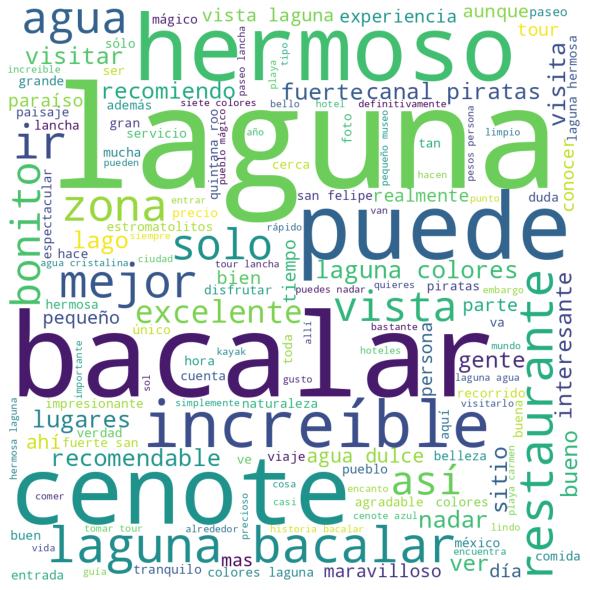

Cadereyta


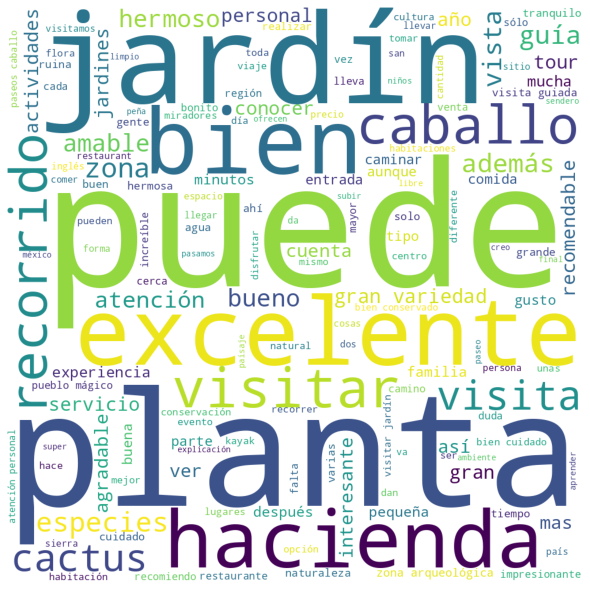

Calvillo


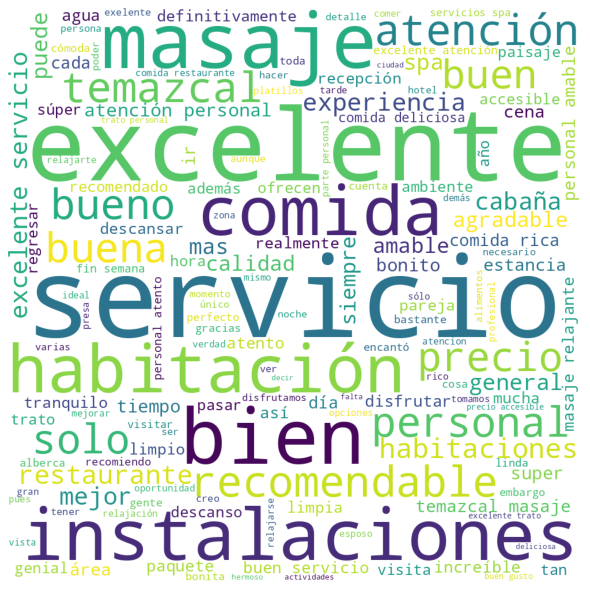

Chiapa_de_Corzo


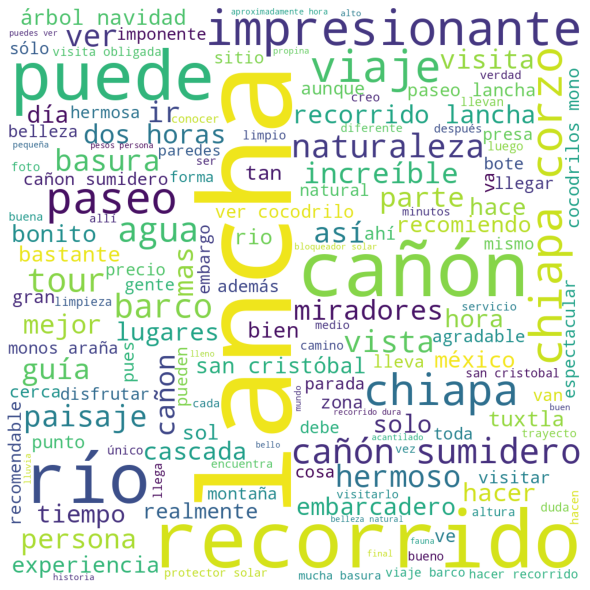

Chignahuapan


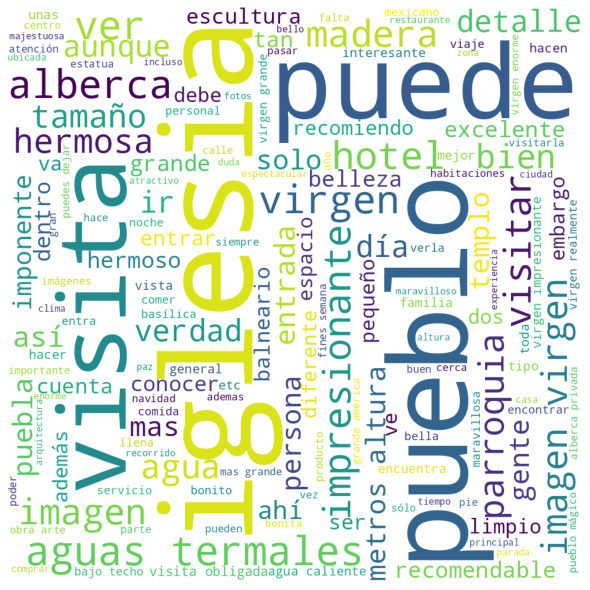

Cholula


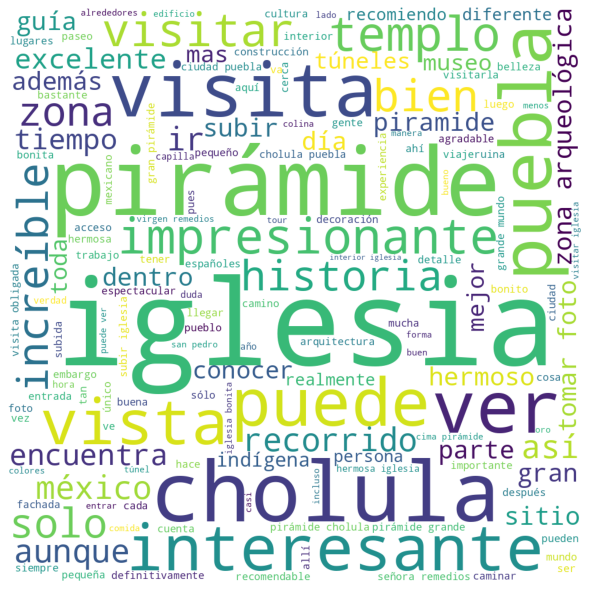

Coatepec


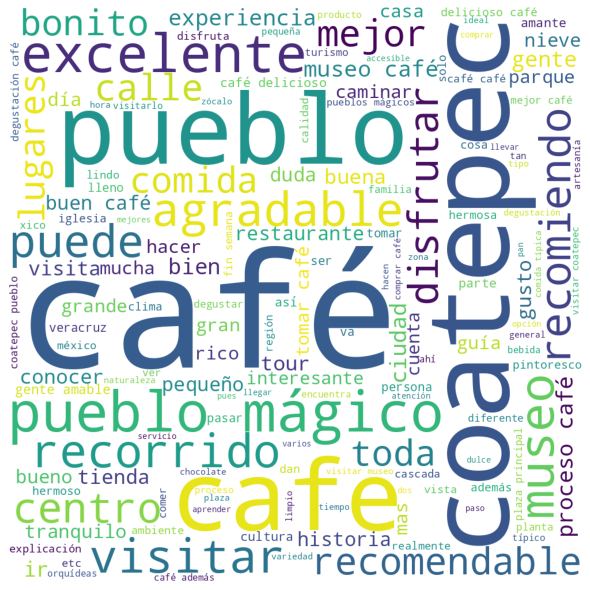

Comala


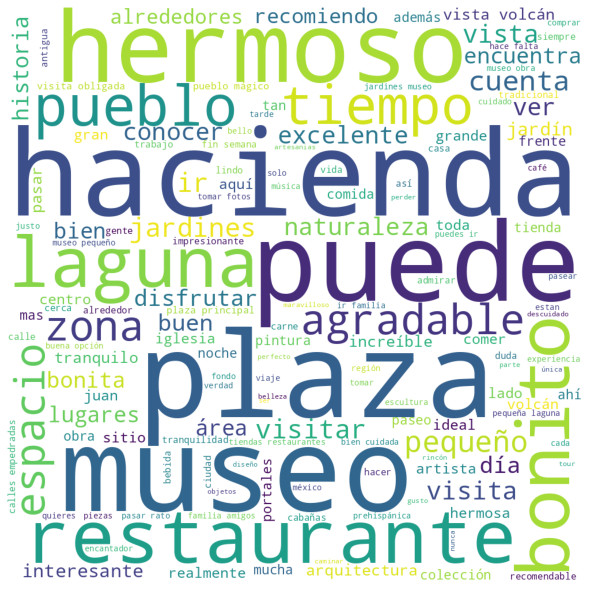

Comitan


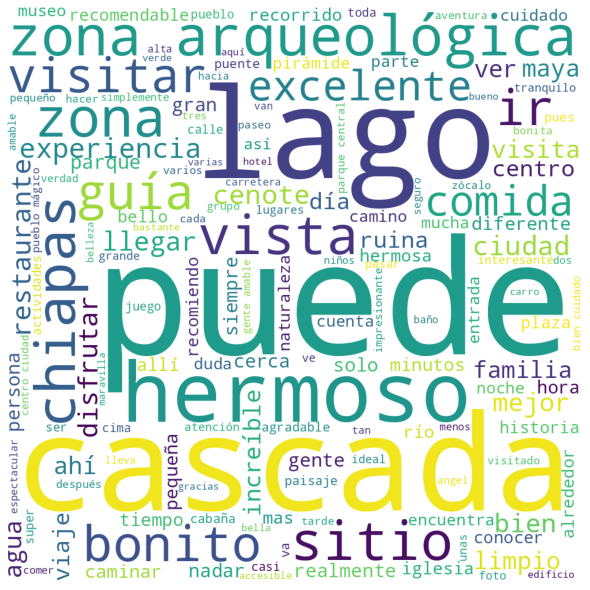

Creel


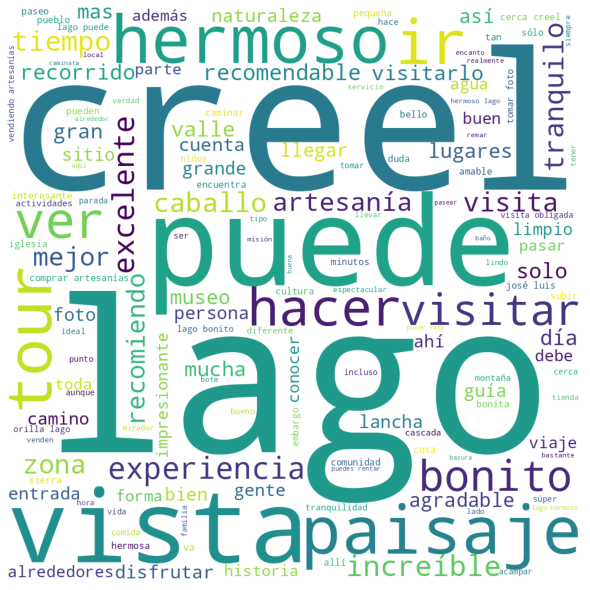

Cuatro_Cienegas


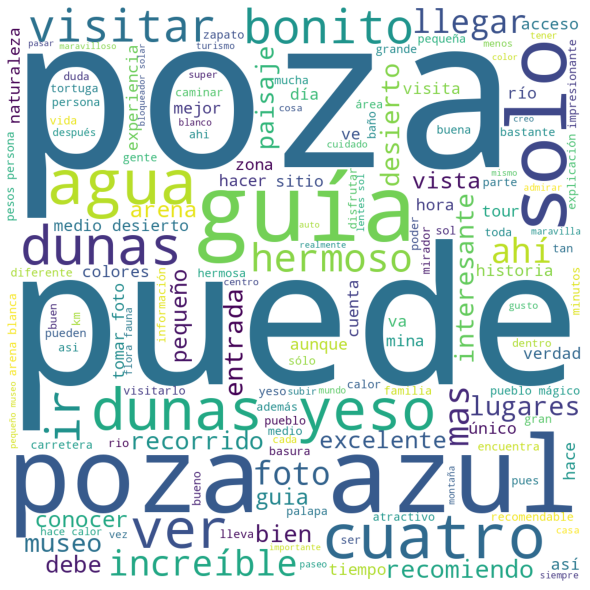

Cuetzalan


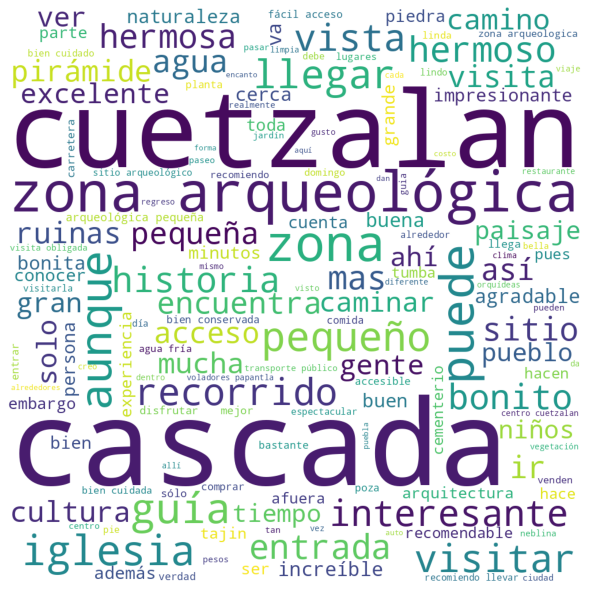

Dolores_Hidalgo


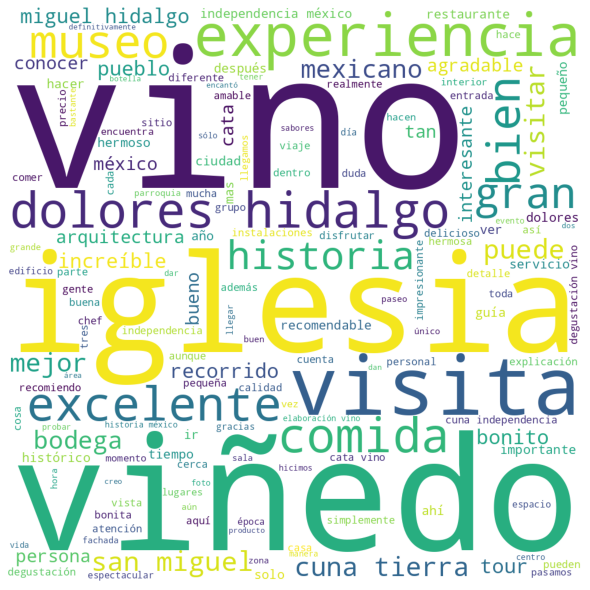

El_Fuerte


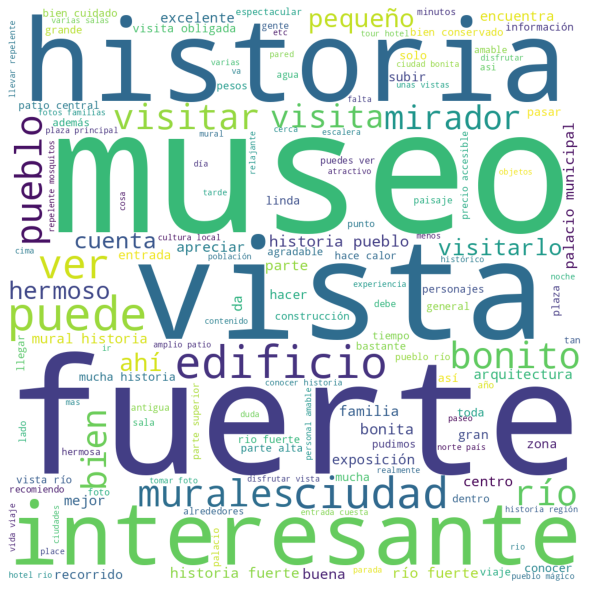

El_Oro


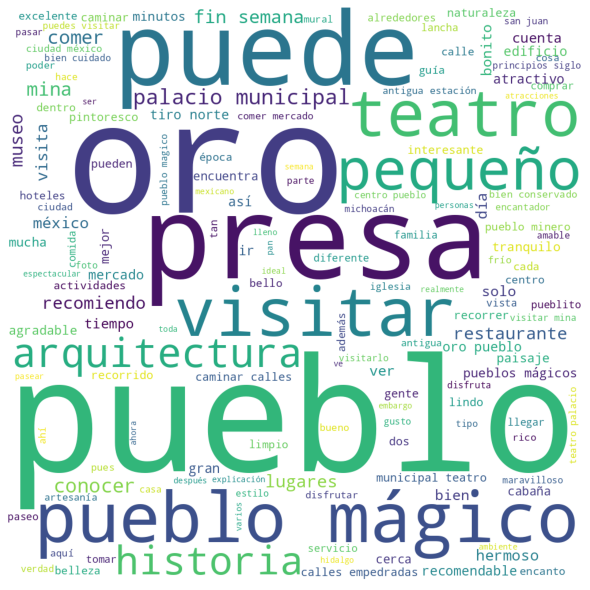

Guadalupe


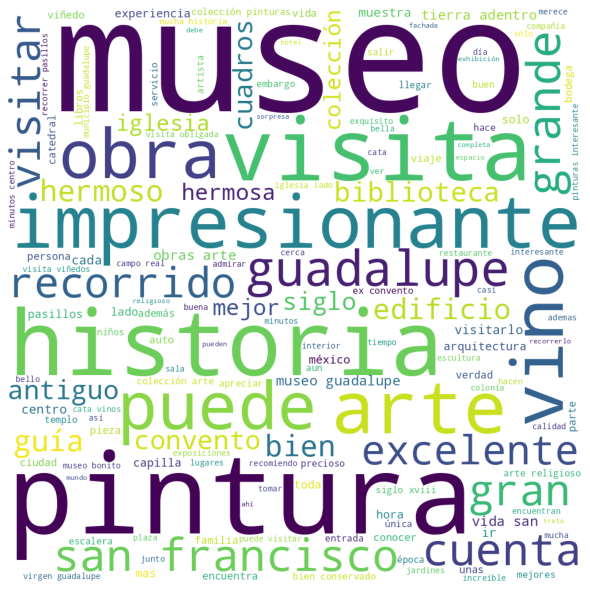

Huamantla


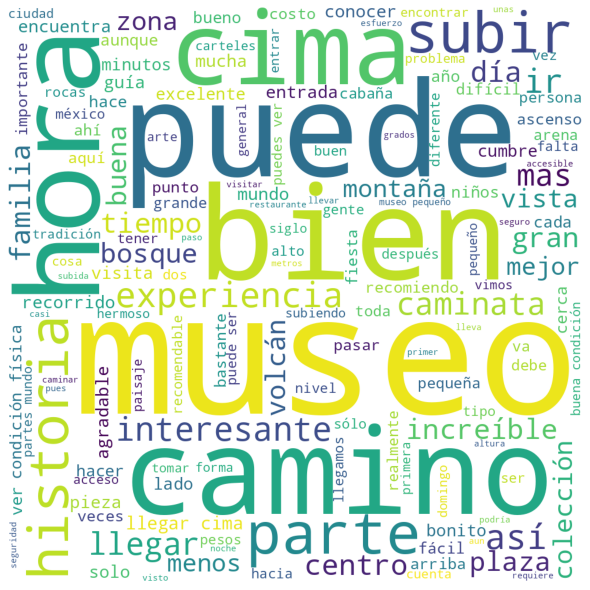

Huasca_de_Ocampo


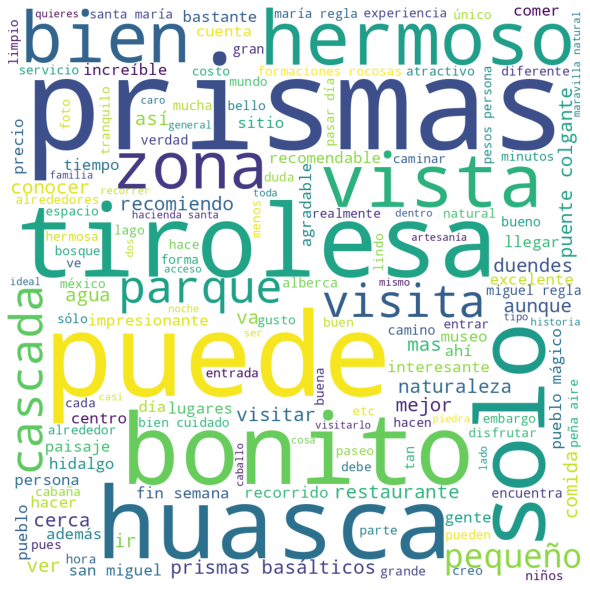

Isla_Mujeres


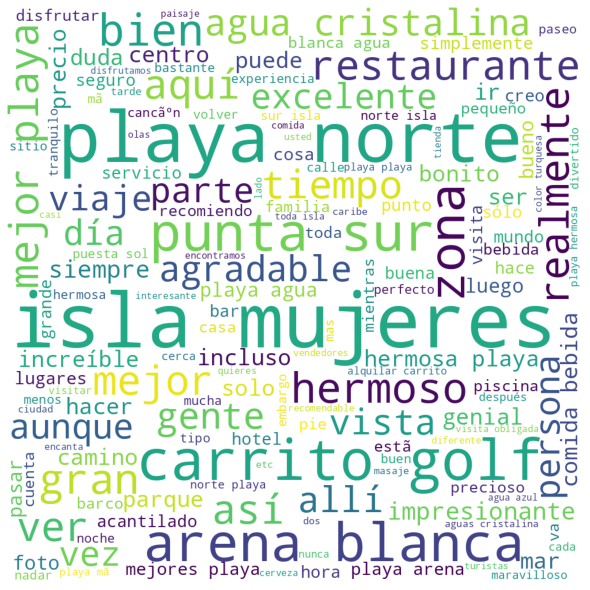

Ixtapan_de_la_Sal


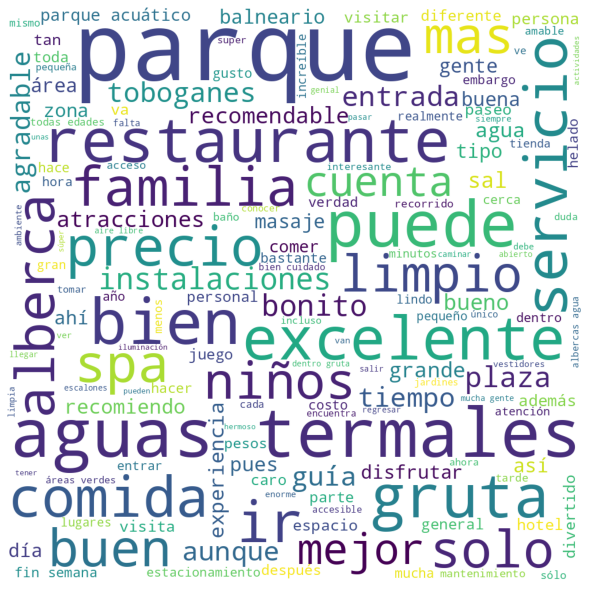

Izamal


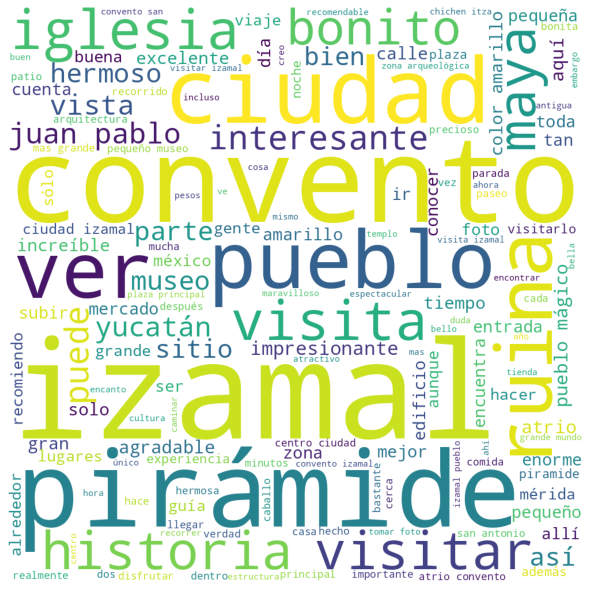

Jalpan


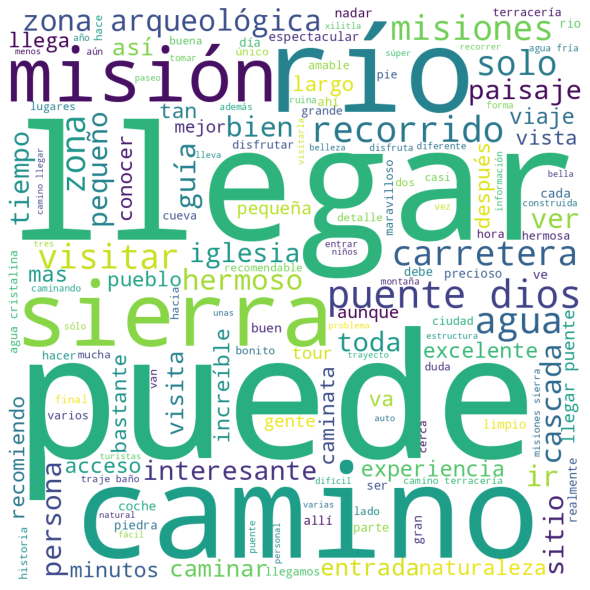

Lagos_de_Moreno


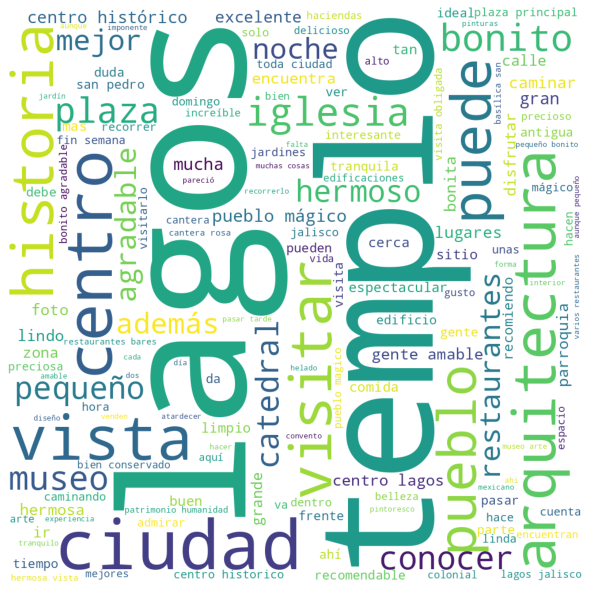

Loreto


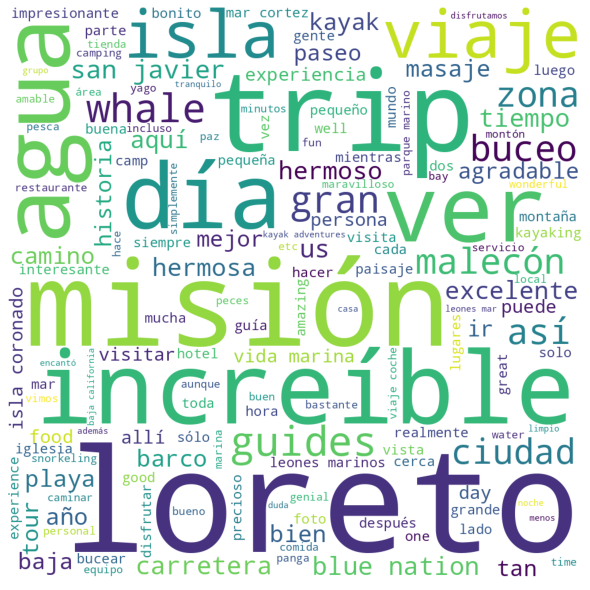

Malinalco


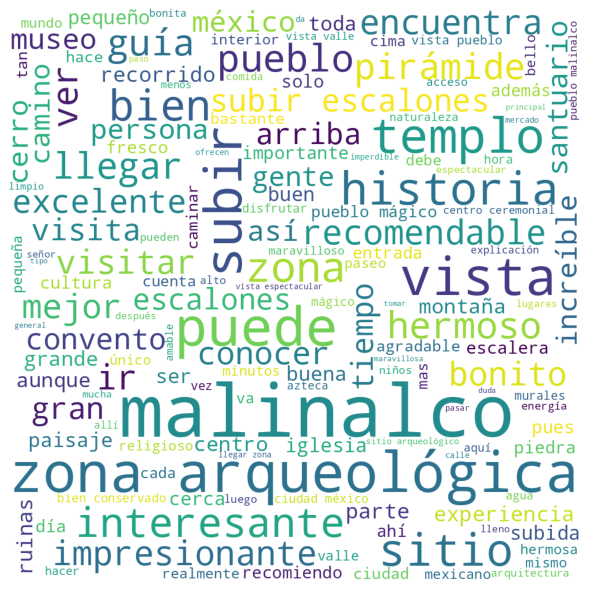

Mascota


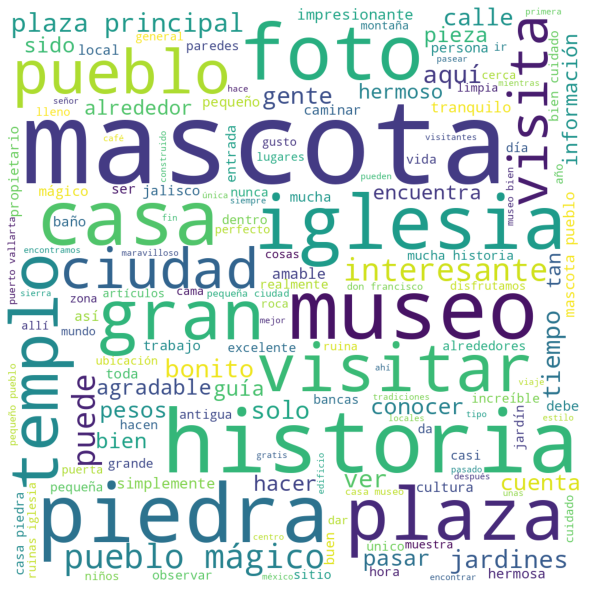

Mazamitla


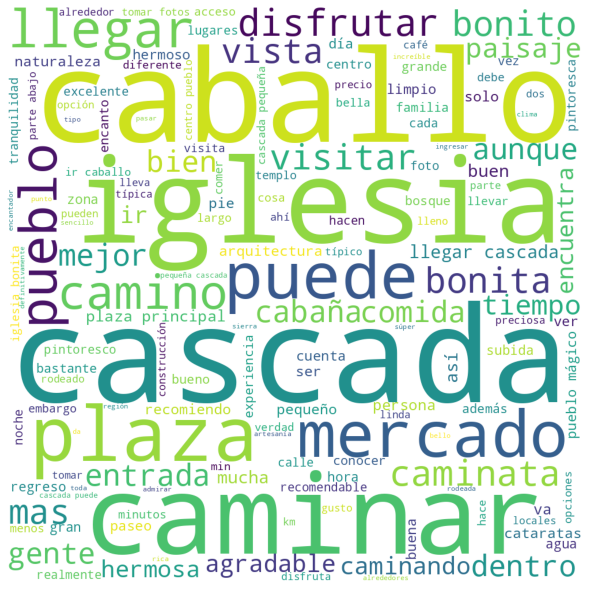

Mazunte


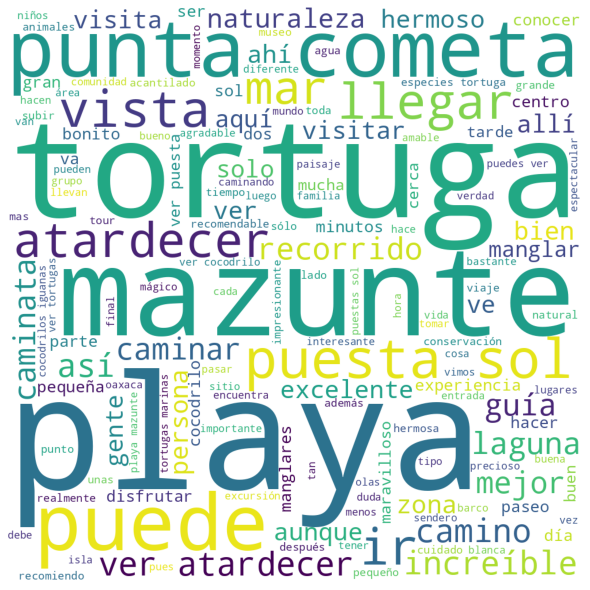

Metepec


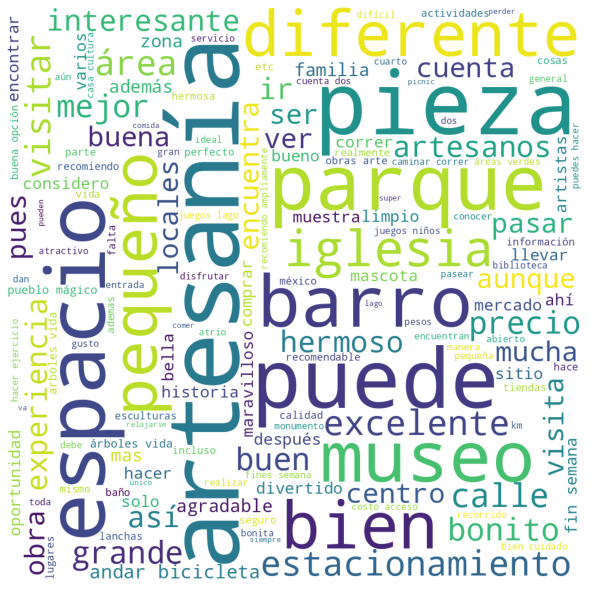

Mineral_de_Pozos


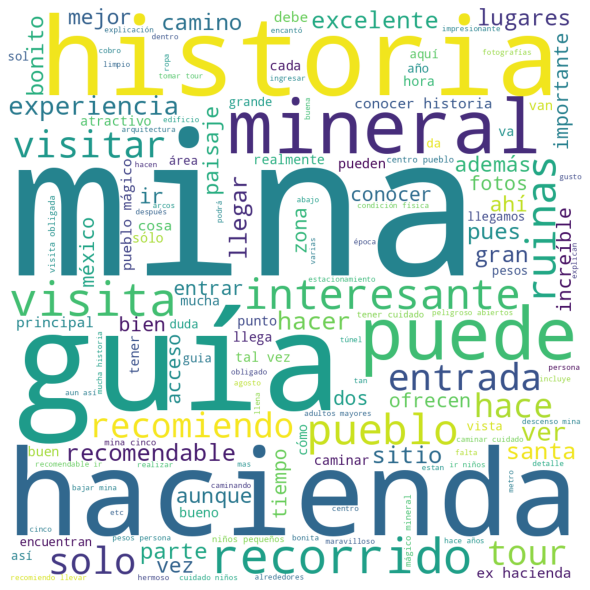

Orizaba


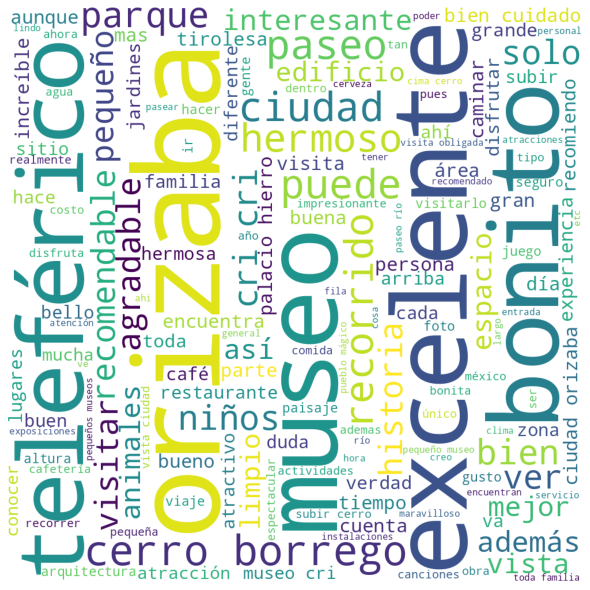

Palenque


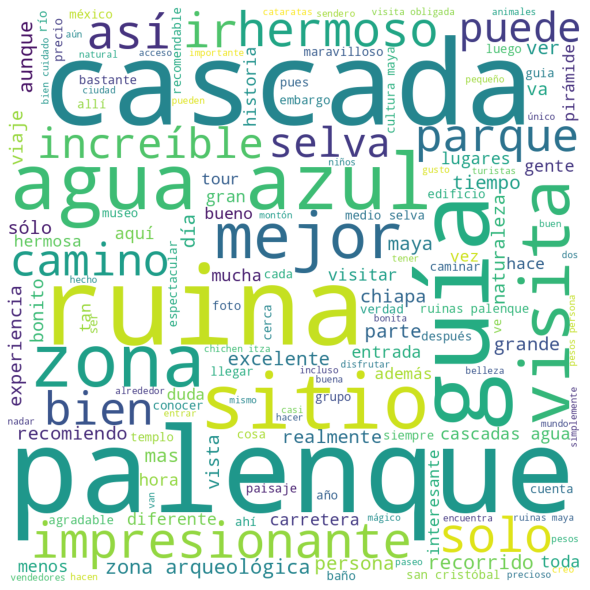

Papantla


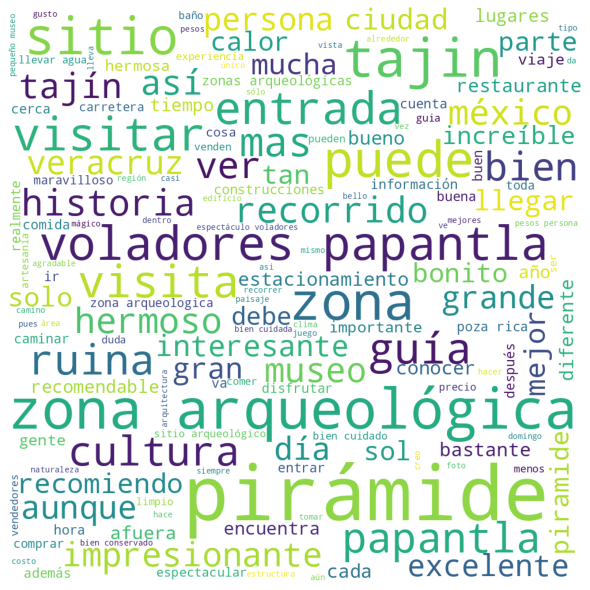

Parras


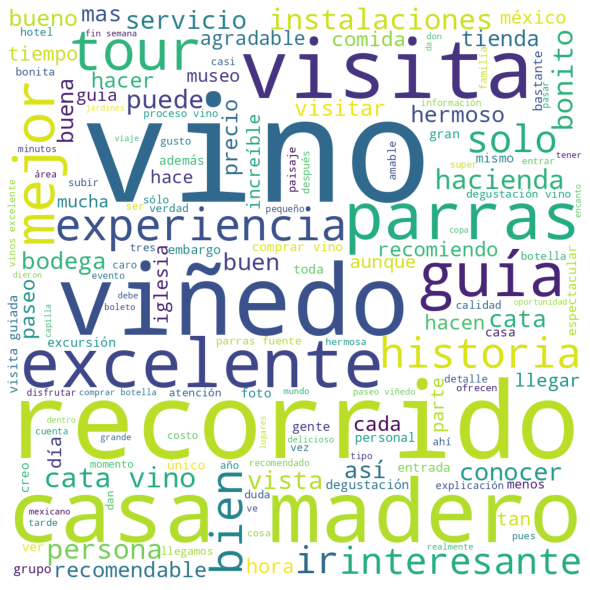

Patzcuaro


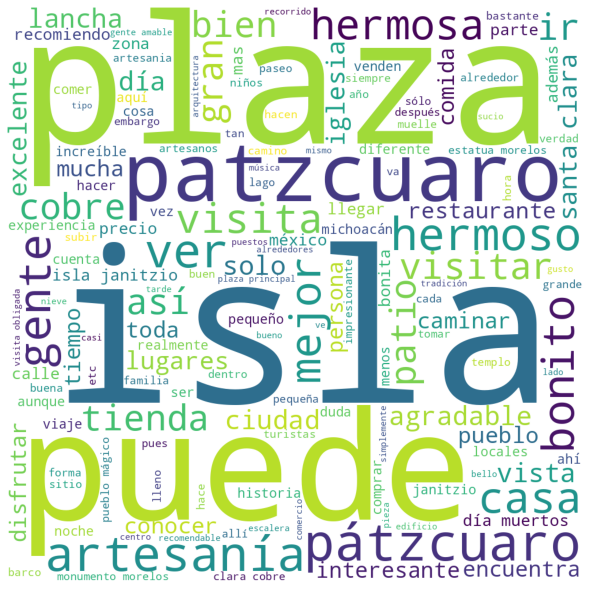

Real_de_Catorce


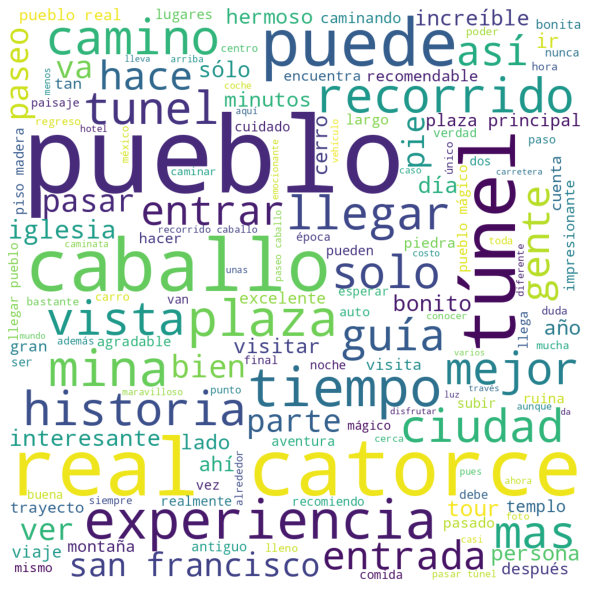

SanJosédeGracia


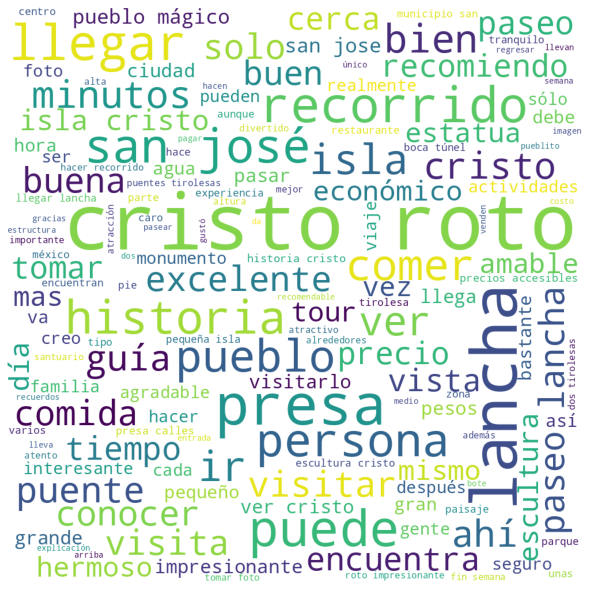

San_Cristobal_de_las_Casas


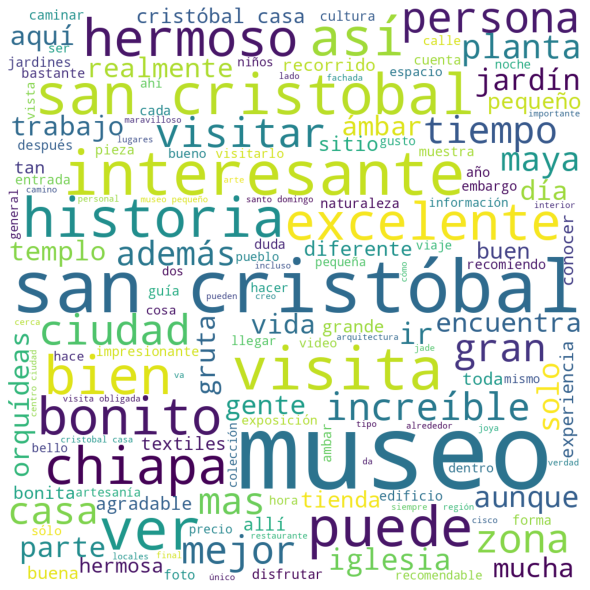

San_Pablo_Villa_de_Mitla


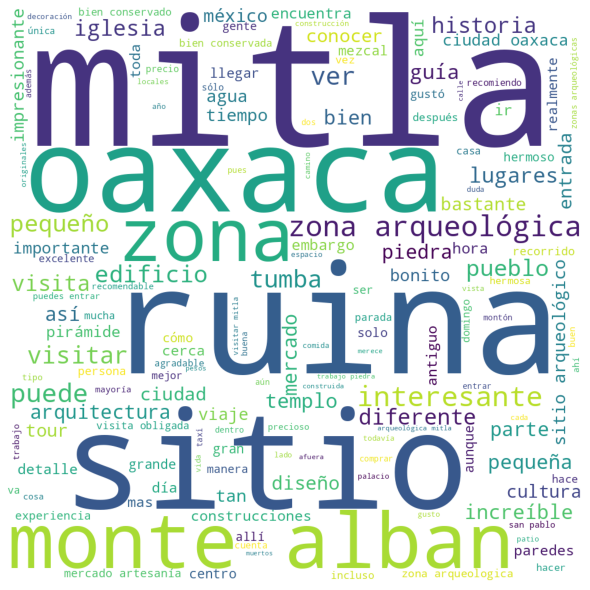

Santiago


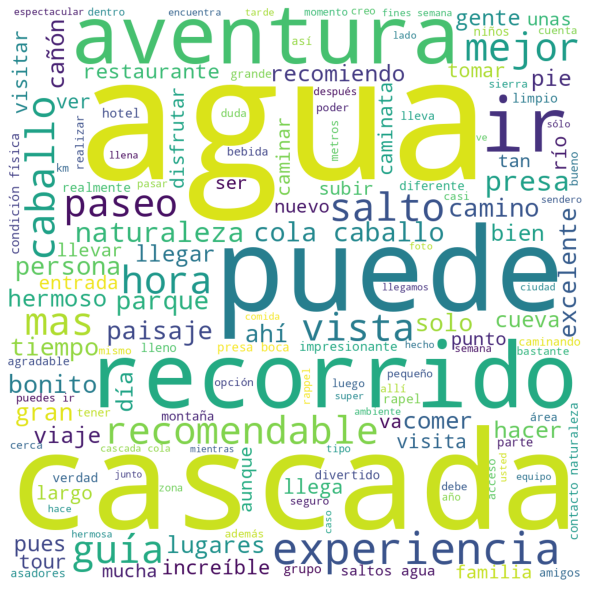

Sayulita


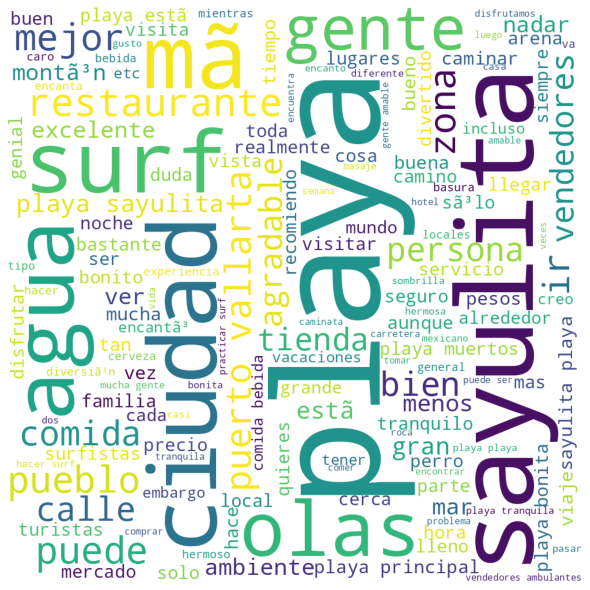

Tapalpa


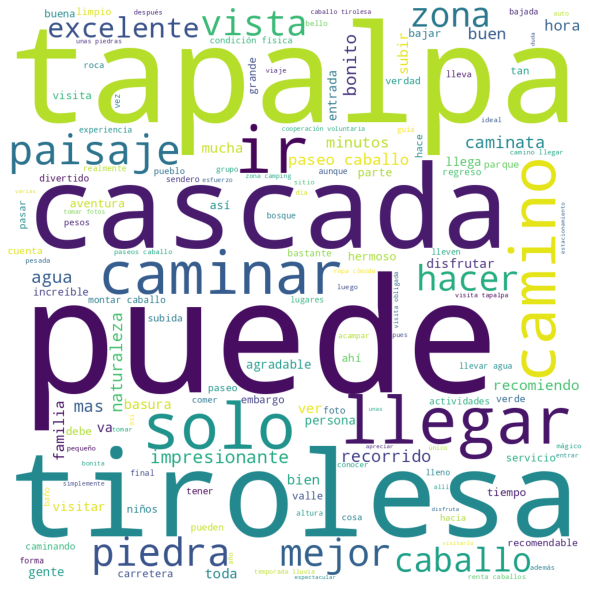

Taxco


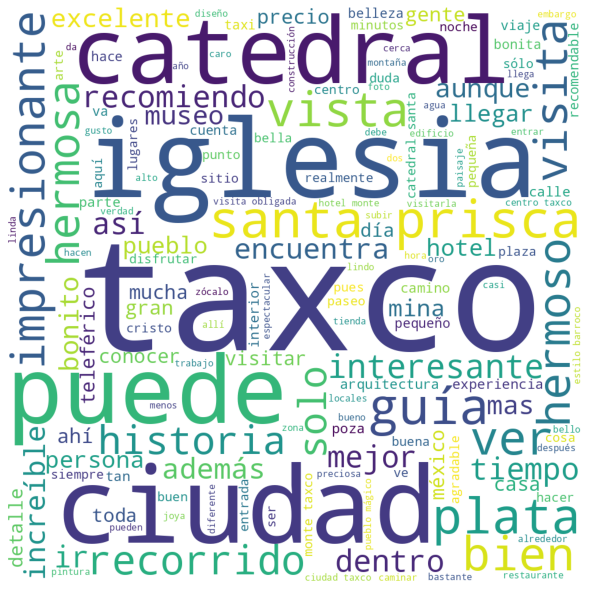

Tecozautla


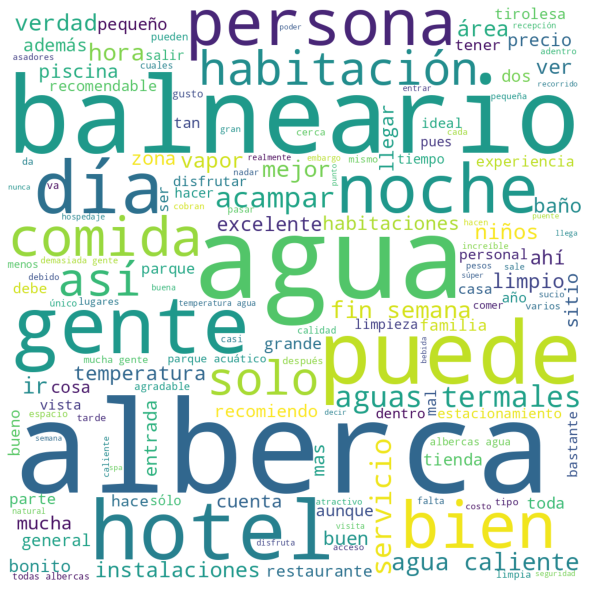

Teotihuacan


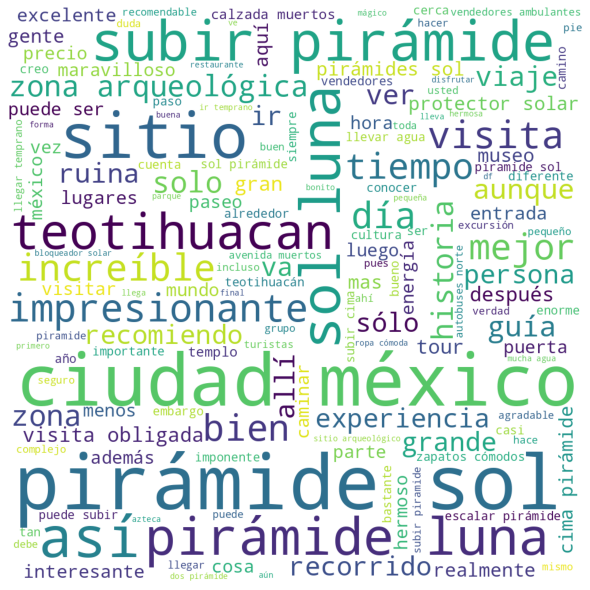

Tepotzotlan


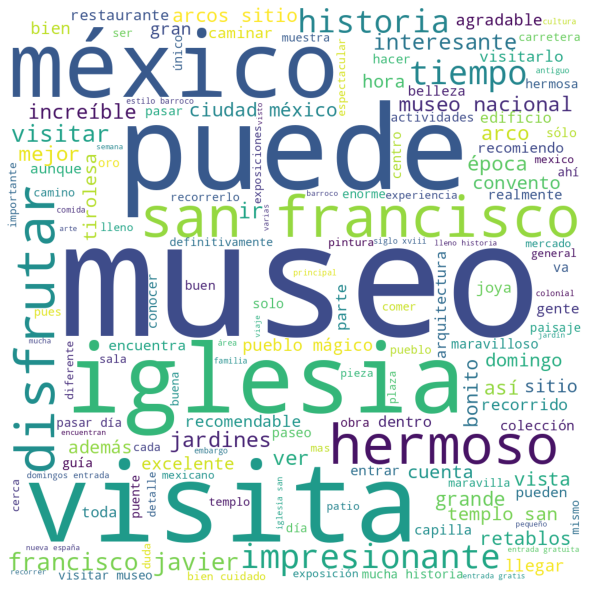

Tepoztlan


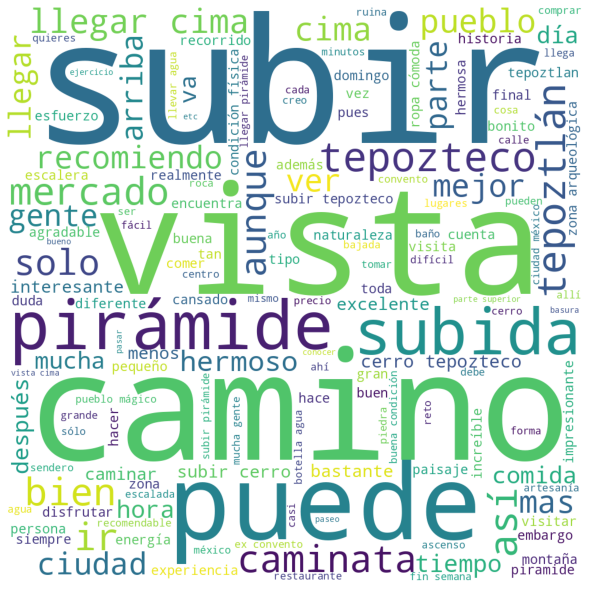

Tequila


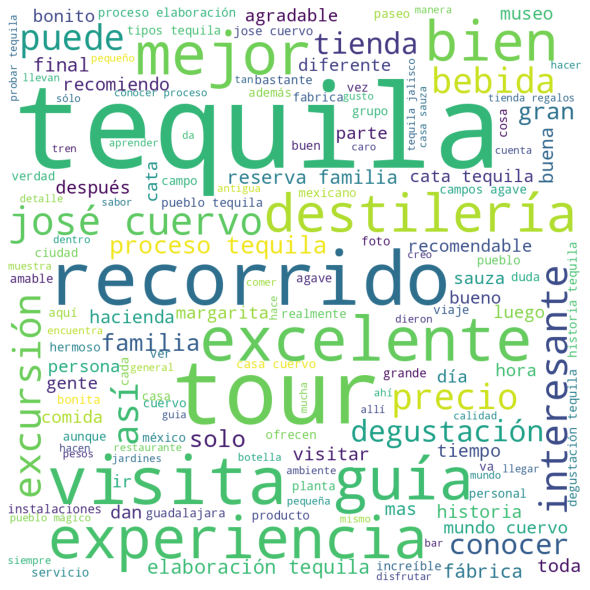

Tequisquiapan


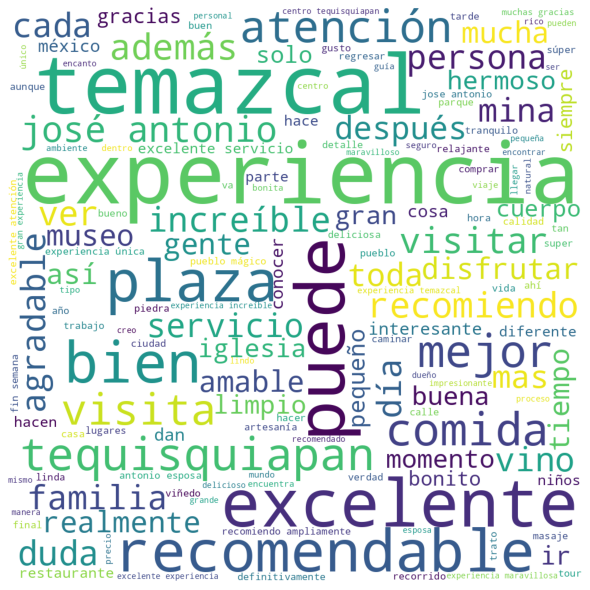

Tlalpujahua


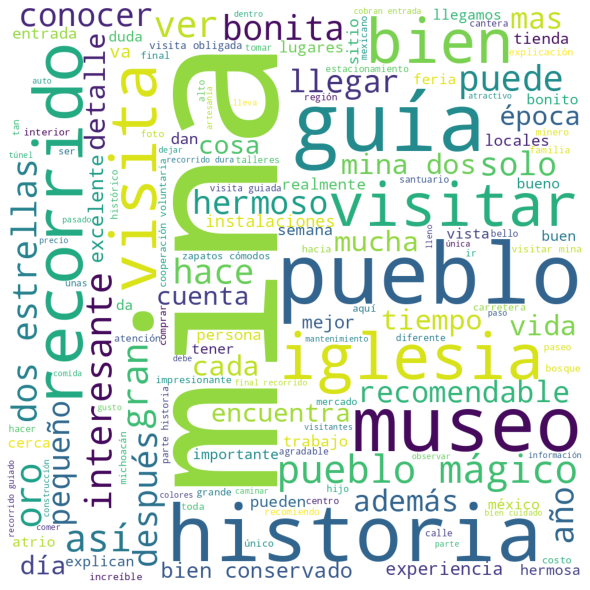

Tlaquepaque


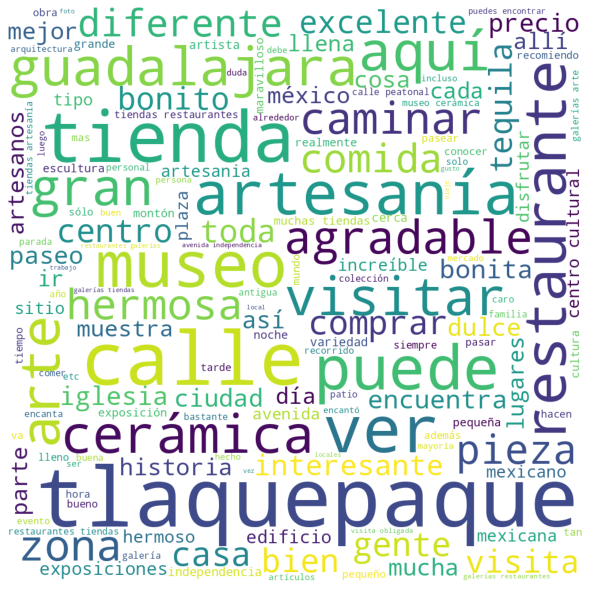

Tlayacapan


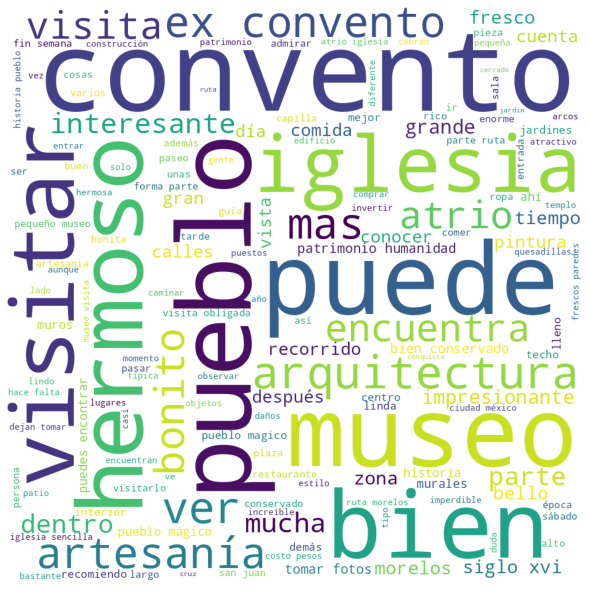

TodosSantos


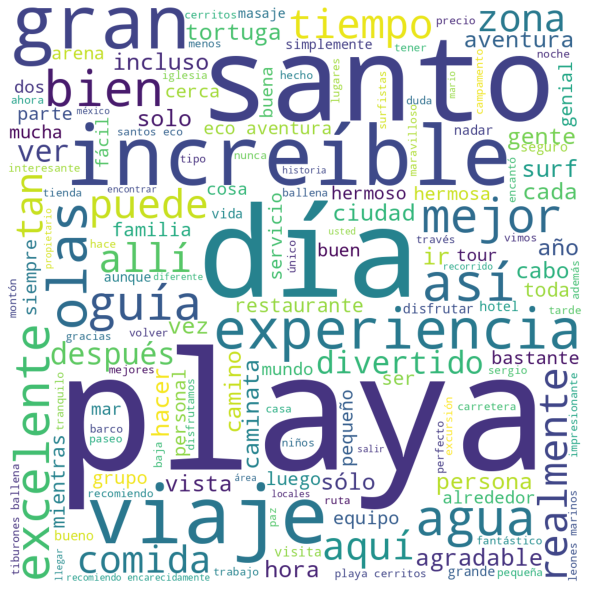

Tulum


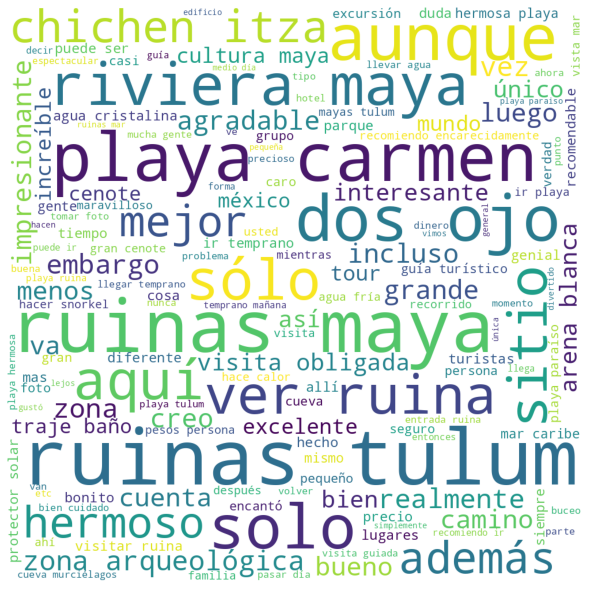

Tzintzuntzan


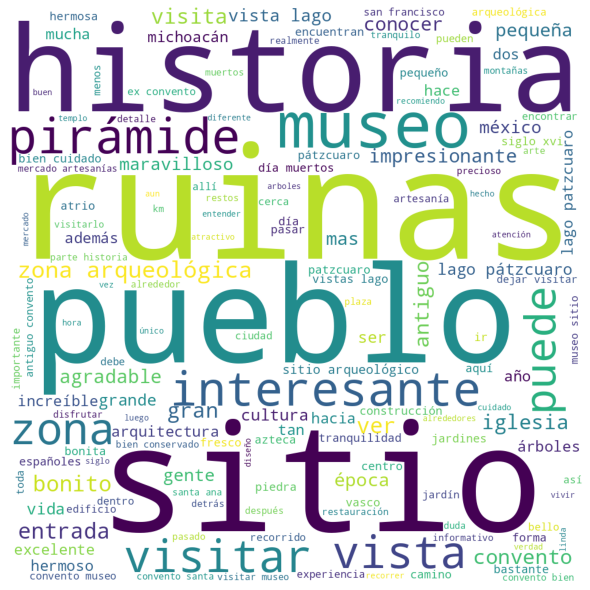

Valladolid


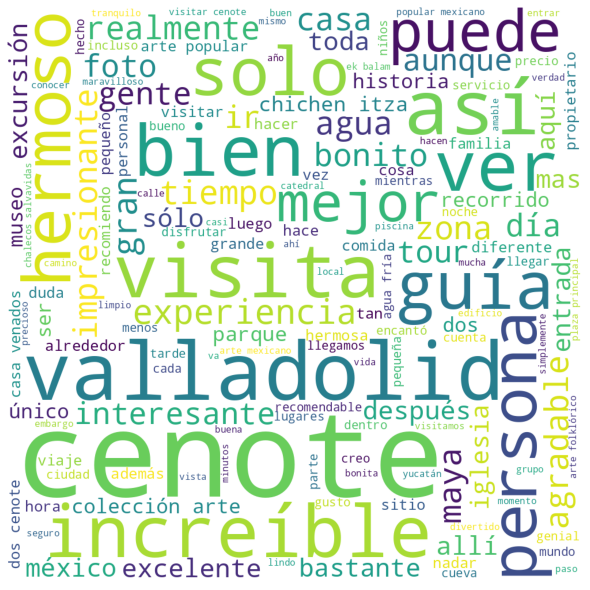

Valle_de_Bravo


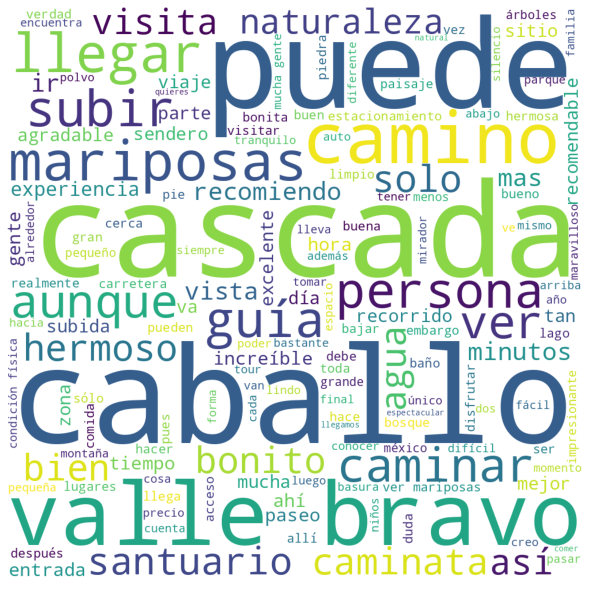

Xico


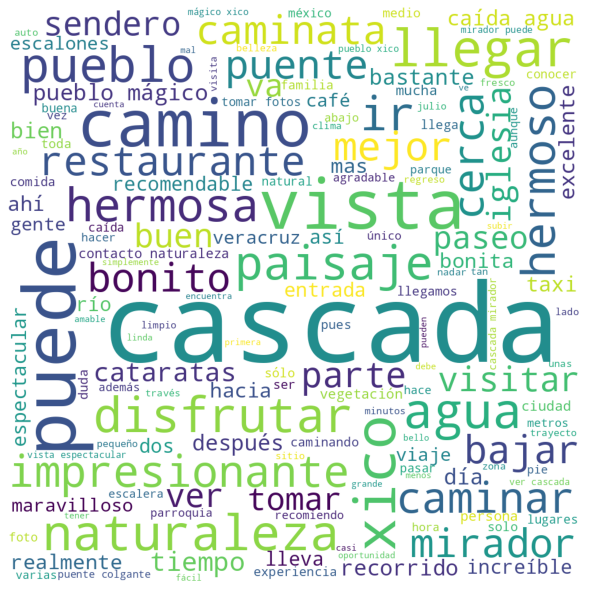

Xilitla


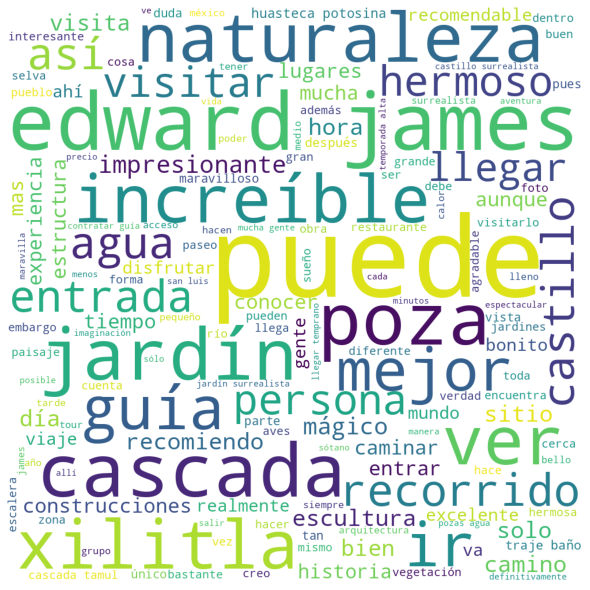

Zacatlan


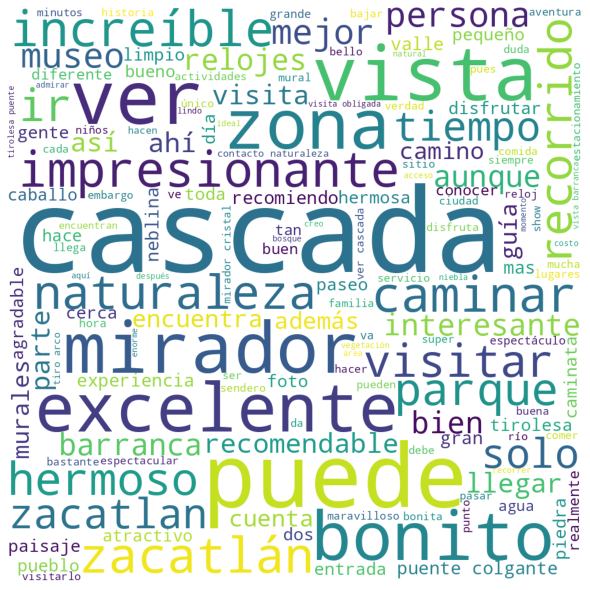

In [ ]:
pueblos = list(datosClasificacionPorPueblosMagicos['Pueblo']);
for pueblo in sorted(list(set(pueblos))):
  print(pueblo)
  nuebDePalabrasPorPuebloDiscriminado(nuevosTextosParaNubesPorPueblo, pueblos, pueblo);


## Classification

In [ ]:
y = [];
for i in range(len(datosClasificacionPorPueblosMagicos)):
  pueblo = datosClasificacionPorPueblosMagicos['Pueblo'].iloc[i];
  y.append(pueblosFinales.index(pueblo));

print(len(y))
y = np.array(y);


In [ ]:
new_dfPueblos, vocPueblos = preprocessText(list(datosClasificacionPorPueblosMagicos['Review']), bigramas=0, minrep=30);


Se han truncado las últimas 5000 líneas del flujo de salida.
8227/13226
8228/13226
8229/13226
8230/13226
8231/13226
8232/13226
8233/13226
8234/13226
8235/13226
8236/13226
8237/13226
8238/13226
8239/13226
8240/13226
8241/13226
8242/13226
8243/13226
8244/13226
8245/13226
8246/13226
8247/13226
8248/13226
8249/13226
8250/13226
8251/13226
8252/13226
8253/13226
8254/13226
8255/13226
8256/13226
8257/13226
8258/13226
8259/13226
8260/13226
8261/13226
8262/13226
8263/13226
8264/13226
8265/13226
8266/13226
8267/13226
8268/13226
8269/13226
8270/13226
8271/13226
8272/13226
8273/13226
8274/13226
8275/13226
8276/13226
8277/13226
8278/13226
8279/13226
8280/13226
8281/13226
8282/13226
8283/13226
8284/13226
8285/13226
8286/13226
8287/13226
8288/13226
8289/13226
8290/13226
8291/13226
8292/13226
8293/13226
8294/13226
8295/13226
8296/13226
8297/13226
8298/13226
8299/13226
8300/13226
8301/13226
8302/13226
8303/13226
8304/13226
8305/13226
8306/13226
8307/13226
8308/13226
8309/13226
8310/13226
8311/13226
8312

In [ ]:
vectorizer = CountVectorizer()
X = vectorizer.fit_transform(new_dfPueblos)
voc = vectorizer.get_feature_names_out()
print(len(voc))

1705


In [ ]:
from sklearn.neighbors import KNeighborsClassifier
from sklearn.model_selection import StratifiedKFold, KFold
#clf = KNeighborsClassifier(n_neighbors=3).fit(X, y);

In [ ]:
#resultados = clf.predict(X)

In [ ]:
def generaMatrizDeConfusion(clases):
  mat = list();
  for i in range(clases):
    row = list();
    for j in range(clases):
      row.append(0);
    mat.append(row);


  return np.array(mat)

def matrizDeConfusion(clases):
  clases = len(list(set(clases)));
  return generaMatrizDeConfusion(clases);

def prediccionesAlaMatriz(mat, truth, predicciones):

  for i in range(len(truth)):
    mat[truth[i]][predicciones[i]] += 1;

  return mat;

def accuracyMat(mat):
  diagonal = sum(mat[i][i] for i in range(len(mat)));
  accuracy = diagonal * 100.0 / sum(sum(mat));
  return accuracy;

def recall_micro_measure(mat, clase):
  if sum(mat)[clase] > 0:
    return 1.0*mat[clase][clase] / sum(mat)[clase];
  else:
    return 0.0;

def precision_micro_measure(mat, clase):
  if np.sum(mat, axis=1)[clase] > 0:
    return 1.0*mat[clase][clase] / np.sum(mat, axis=1)[clase];
  else:
    return 0.0;

def f1_micro_measure(mat, clase):
  recall = recall_micro_measure(mat, clase);
  precision = precision_micro_measure(mat, clase);
  nominador = 2.0 *precision*recall;
  denominador = precision + recall;
  if denominador > 0:
    return nominador/denominador;
  else:
    return 0.0;

def recall_measure(mat):
  recall = list()
  for i in range(len(mat)):
      recall.append(recall_micro_measure(mat, i));
  recall = np.array(recall);
  print("Recall " + str(recall));
  return recall.mean();

def precision_measure(mat):
  precision = list()
  for i in range(len(mat)):
    precision.append(precision_micro_measure(mat, i));
  precision = np.array(precision);
  print("Precision " + str(precision));
  return precision.mean();

def f1_measure(mat):
  f1 = list()
  for i in range(len(mat)):
    f1.append(f1_micro_measure(mat, i));
  f1 = np.array(f1);
  print("F-measure " + str(f1));
  return f1.mean();

def get_mae(mat):
  sum = 0;
  n = 0;
  for i in range(len(mat)):
    for j in range(len(mat[i])):
      sum += mat[i][j]*abs(i-j);
      n += mat[i][j];
  mae = float(sum) / float(n)
  return mae;

def get_mse(mat):
  sum = 0;
  n = 0;
  for i in range(len(mat)):
    for j in range(len(mat[i])):
      sum += mat[i][j]*(abs((i-j) * (i-j)));
      n += mat[i][j];
  mse = float(sum) / float(n)
  return mse;

def get_rmse(mat):
  sum = 0;
  n = 0;
  for i in range(len(mat)):
    for j in range(len(mat[i])):
      sum += mat[i][j]*(abs((i-j) * (i-j)));
      n += mat[i][j];
  rmse = float(sum) / float(n)
  return np.sqrt(rmse);


def getSentimentScore(matPolarity, matAttractive):

  mae = get_mae(matPolarity);
  fPromedio = 0.0;
  for clase in range(len(matAttractive)):
    fPromedio += f1_micro_measure(matAttractive, clase);
  fPromedio /=3;

  return ((1/(1+mae)) + fPromedio)/2.0;

def getSemaphoreScore(mats):

   f0 = f1_measure(mats[0]);
   f2 = f1_measure(mats[1]);
   f4 = f1_measure(mats[2]);
   f8 = f1_measure(mats[3]);

   return (f0 + (2*f2) + (4*f4) + (8*f8))/15.0;



def estadisticas(mat, clasificador):
  print("Estadísticas para " + clasificador)
  print(mat)
  print("Accuracy: " + str(accuracyMat(mat)));
  r = recall_measure(mat)
  print("Recall macro: " + str(r))
  p = precision_measure(mat)
  print("Precision macro: " + str(p))
  f1 = f1_measure(mat)
  print("F1-measure macro: " + str(f1))
  mae = get_mae(mat)
  print("MAE: " + str(mae))
  mse = get_mse(mat)
  print("MSE: " + str(mse))
  rmse = get_rmse(mat)
  print("RMSE: " + str(rmse))


In [ ]:
def clf_KNN(X, y, k = 1, n = 10):
  print("Clasifiacion con KNN")
  kf = StratifiedKFold(n_splits=n)
  kf.get_n_splits(X)
  i = 1;
  mat = matrizDeConfusion(y);
  for train_index, test_index in kf.split(X,y):
    #print("TRAIN:", train_index, "TEST:", test_index)
    X_train, X_test = X[train_index], X[test_index]
    y_train, y_test = y[train_index], y[test_index]
    clf = KNeighborsClassifier(n_neighbors=k).fit(X_train, y_train);
    predicciones = clf.predict(X_test)
    mat = prediccionesAlaMatriz(mat, y_test, predicciones);
    print("Listo fold " + str(i));
    i+=1;

  #estadisticas(mat,"KNN con k = " + str(k));
  return mat;

In [ ]:
def heatmap(data, row_labels, col_labels, ax = None,
            cbar_kw = {}, cbarlabel = "", **kwargs):

    if not ax:
      ax = plt.gca()

    im = ax.imshow(data, **kwargs)

    cbar = ax.figure.colorbar(im, ax = ax, **cbar_kw)
    cbar.ax.set_ylabel(cbarlabel, rotation = -90, va = "bottom")

    ax.set_xticks(np.arange(data.shape[1]), labels = col_labels)
    ax.set_yticks(np.arange(data.shape[0]), labels = row_labels)

    ax.tick_params(top = True, bottom = False,
                   labeltop = True, labelbottom = False)

    plt.setp(ax.get_xticklabels(), rotation = -30, ha = "right",
             rotation_mode = "anchor")

    ax.spines[:].set_visible(False)

    ax.set_xticks(np.arange(data.shape[1] + 1) - 0.5, minor = True)
    ax.set_yticks(np.arange(data.shape[0] + 1) - 0.5, minor = True)
    ax.grid(which = "minor", color = "w", linestyle = '-', linewidth = 3)
    ax.tick_params(which =  "minor", bottom = False, left = False)
    plt.figure(figsize = (50,50))

    return im, cbar


def annotate_heatmap(im, data = None, valfmt="{x:.2f}",
                     textcolors = ("black", "white"),
                     threshold = None, **textkw):

    if not isinstance(data, (list, np.ndarray)):
        data = im.get_array()

    if threshold is not None:
        threshold = im.norm(threshold)
    else:
        threshold = im.norm(data.max())/2.

    kw = dict(horizontalalignment = "center",
              verticalalignment = "center")
    kw.update(textkw)

    if isinstance(valfmt, str):
        valfmt = matplotlib.ticker.StrMethodFormatter(valfmt)

    texts = []
    for i in range(data.shape[0]):
        for j in range(data.shape[1]):
            kw.update(color=textcolors[int(im.norm(data[i, j]) > threshold)])
            text = im.axes.text(j, i, valfmt(data[i, j], None), **kw)
            texts.append(text)

    return texts

In [ ]:
#print(len(y));
#print(len(resultados))
mat = clf_KNN(X, y, k= 5, n = 5);

Clasifiacion con KNN
Listo fold 1
Listo fold 2
Listo fold 3
Listo fold 4
Listo fold 5


In [ ]:
mat

array([[4843,  297,  631],
       [1453, 1751,  896],
       [1160,  342, 1853]])

In [ ]:
import numpy as np
import matplotlib.pyplot as plt



def evaluaSentiment(truth, predicciones, pueblosFinales):

  mat = matrizDeConfusion(truth);

  mat = prediccionesAlaMatriz(mat, truth, predicciones=predicciones);

  xlabs = pueblosFinales
  ylabs = pueblosFinales

  fig, ax = plt.subplots()
  heatmap(mat, row_labels = xlabs, col_labels = ylabs,
        ax = ax, cmap = "Blues", cbarlabel = "Label")


  estadisticas(mat, "KNN");


def evaluaMat(mat, pueblosFinales):


  xlabs = pueblosFinales
  ylabs = pueblosFinales

  matLog = np.log10(mat)
  fig, ax = plt.subplots()
  heatmap(matLog, row_labels = xlabs, col_labels = ylabs,
        ax = ax, cmap = "Blues", cbarlabel = "Label")


  estadisticas(mat, "KNN");





Estadísticas para KNN
[[4843  297  631]
 [1453 1751  896]
 [1160  342 1853]]
Accuracy: 63.86662634205353
Recall [0.64954399 0.73263598 0.54822485]
Recall macro: 0.6434682755836377
Precision [0.83919598 0.42707317 0.55230999]
Precision macro: 0.6061930452426917
F-measure [0.73229001 0.53959938 0.55025984]
F1-measure macro: 0.6073830777312565
MAE: 0.49674882806593074
MSE: 0.7675790110388628
RMSE: 0.8761158662179694


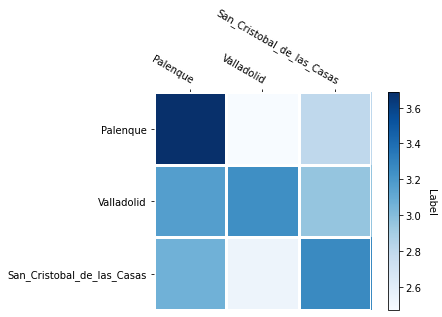

<Figure size 3600x3600 with 0 Axes>

In [ ]:
evaluaMat(mat, pueblosFinales);

Estadísticas para KNN
[[4843  297  631]
 [1453 1751  896]
 [1160  342 1853]]
Accuracy: 63.86662634205353
Recall [0.64954399 0.73263598 0.54822485]
Recall macro: 0.6434682755836377
Precision [0.83919598 0.42707317 0.55230999]
Precision macro: 0.6061930452426917
F-measure [0.73229001 0.53959938 0.55025984]
F1-measure macro: 0.6073830777312565
MAE: 0.49674882806593074
MSE: 0.7675790110388628
RMSE: 0.8761158662179694


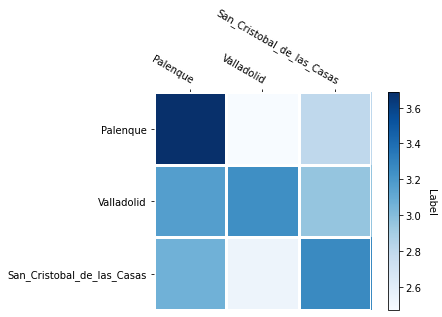

<Figure size 3600x3600 with 0 Axes>

In [ ]:
evaluaMat(mat, pueblosFinales);

In [ ]:
#%tensorflow_version 2.x
import tensorflow as tf
from tensorflow import keras
from keras import backend as K

def recall_m(y_true, y_pred):
    true_positives = K.sum(K.round(K.clip(y_true * y_pred, 0, 1)))
    possible_positives = K.sum(K.round(K.clip(y_true, 0, 1)))
    recall = true_positives / (possible_positives + K.epsilon())
    return recall

def precision_m(y_true, y_pred):
    true_positives = K.sum(K.round(K.clip(y_true * y_pred, 0, 1)))
    predicted_positives = K.sum(K.round(K.clip(y_pred, 0, 1)))
    precision = true_positives / (predicted_positives + K.epsilon())
    return precision

def f1_m(y_true, y_pred):
    precision = precision_m(y_true, y_pred)
    recall = recall_m(y_true, y_pred)
    return 2*((precision*recall)/(precision+recall+K.epsilon()))

In [ ]:
def MLP(X, y, lugares, n=5):


  acc_per_fold = []
  loss_per_fold = []
  f_m_per_fold = []

  kfold = KFold(n_splits=n, shuffle=True)
  y_resp = y;
  y2 = tf.keras.utils.to_categorical(y, len(lugares));
  fold_no = 1
  mat = generaMatrizDeConfusion(clases=len(lugares));
  for train, test in kfold.split(X, y2):


    model = tf.keras.models.Sequential([


                                        tf.keras.layers.Dense(100, activation='relu'),
                                        tf.keras.layers.Dense(100, activation='relu'),
                                        tf.keras.layers.Dense(100, activation='relu'),
                                        tf.keras.layers.Dense(100, activation='relu'),
                                        #tf.keras.layers.Dense(1000, activation='relu'),
                                        #tf.keras.layers.Dense(1000, activation='relu'),
                                        #tf.keras.layers.Dense(1000, activation='relu'),
                                        #tf.keras.layers.Dense(1000, activation='relu'),
                                        #tf.keras.layers.Dense(1000, activation='relu'),
                                        #tf.keras.layers.Dense(1000, activation='relu'),
                                        tf.keras.layers.Dense(len(lugares), activation='softmax' )
    ])

    model.compile(optimizer='adam',
                  loss='categorical_crossentropy',
                  #metrics=['accuracy', f1_m, precision_m, recall_m])
                  metrics=[f1_m, precision_m, recall_m])

    print('------------------------------------------------------------------------')
    print(f'Training for fold {fold_no} ...')


    history = model.fit(X[train], y2[train], epochs=5);
    scores = model.evaluate(X[test],  y2[test], verbose=0)
    print(f'Score for fold {fold_no}: {model.metrics_names[0]} of {scores[0]}; {model.metrics_names[1]} of {scores[1]*100}%')
    acc_per_fold.append(scores[1] * 100)
    loss_per_fold.append(scores[0])
    f_m_per_fold.append(scores[2])
    predictions = model.predict_classes(X[test]);
    for i in range(len(predictions)):
      mat[y_resp[test][i]][predictions[i]]+=1;
    fold_no = fold_no + 1


  # == Provide average scores ==
  print('------------------------------------------------------------------------')
  print('Score per fold')
  for i in range(0, len(acc_per_fold)):
    print('------------------------------------------------------------------------')
    print(f'> Fold {i+1} - Loss: {loss_per_fold[i]} - Accuracy: {acc_per_fold[i]} - Fm: {f_m_per_fold[i]}%')
  print('------------------------------------------------------------------------')
  print('Average scores for all folds:')
  print(f'> Accuracy: {np.mean(acc_per_fold)} (+- {np.std(acc_per_fold)})')
  print(f'> Fm: {np.mean(f_m_per_fold)} (+- {np.std(f_m_per_fold)})')
  print(f'> Loss: {np.mean(loss_per_fold)}')
  print('------------------------------------------------------------------------')
  estadisticas(mat, "Deep Learning")


In [ ]:
MLP(X, y, pueblosFinales, n=3)